In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

%matplotlib inline
import matplotlib.pyplot as plt

from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.cm as cm

import numpy as np

import skimage.transform
from scipy import ndimage
import scipy.misc

def image_show(image_path):
  imshow(np.asarray(Image.open(image_path, 'r')))
  plt.axis('off')
  plt.show()

import tensorflow as tf
flags = tf.app.flags
FLAGS = flags.FLAGS

#flags.DEFINE_string('model_dir', '/home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune/', '')
  
import sys, os, math
import gezi, melt
import numpy as np

from deepiu.util import algos_factory
from deepiu.seq2seq.rnn_decoder import SeqDecodeMethod

#debug
from deepiu.util import text2ids

TEXT_MAX_WORDS = 100    
decode_max_words = 20


from deepiu.util import ids2text
vocab_path = '/home/gezi/new/temp/image-caption/ai-challenger/tfrecord/seq-basic-finetune/vocab.txt'
ids2text.init(vocab_path)

image_dir = image_dir = '/home/gezi/data2/data/ai_challenger/image_caption/pic/'
image_file = '6275b5349168ac3fab6a493c509301d023cf39d3.jpg'
image_path = os.path.join(image_dir, image_file)
image_model_checkpoint_path = '/home/gezi/data/image_model_check_point/inception_resnet_v2_2016_08_30.ckpt'
image_model_name='InceptionResnetV2'

FLAGS.model_dir = model_dir = '/home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune.rl/'


if not melt.varname_in_checkpoint(image_model_name, model_dir):
  image_model = melt.image.ImageModel(image_model_checkpoint_path, 
                                      model_name=image_model_name)
else:
  image_model = None

import libpinyin
pinyin = libpinyin.Pinyin()
pinyin.Load('./data/pinyin/')

tensorflow_version: 1.3.0


INFO:tensorflow:Initializing vocabulary from file: /home/gezi/new/temp/image-caption/ai-challenger/tfrecord/seq-basic-finetune/vocab.txt
INFO:tensorflow:Created vocabulary with 10148 words


ENCODE_UNK 1


In [2]:
if 'coverage' in model_dir:
  FLAGS.coverage_attention_wrapper = True

FLAGS.image_encoder = 'Rnn'
FLAGS.showtell_encode_scope = 'encode'
FLAGS.showtell_decode_scope = 'decode'
FLAGS.image_attention_size = 64 
FLAGS.image_endpoint_feature_name = 'Conv2d_7b_1x1'
FLAGS.image_model = 'InceptionResnetV2'
FLAGS.image_checkpoint_file = '/home/gezi/data/image_model_check_point/inception_resnet_v2_2016_08_30.ckpt' 
FLAGS.pre_calc_image_feature = 0 
FLAGS.finetune_image_model = True 
FLAGS.image_features_batch_norm = True 
FLAGS.image_features_drop_out = True
FLAGS.emb_dim = 512 
FLAGS.rnn_hidden_size = 512 
FLAGS.image_feature_len = 1536 * 64
FLAGS.alignment_history = True

beam_size = 10
length_normalization_factor = 0.25

In [3]:
algo = 'show_and_tell'
global_scope = algo
main_scope = 'main'
melt.apps.image_processing.init()
with tf.variable_scope(global_scope):
  with tf.variable_scope(main_scope):
    predictor =  algos_factory.gen_predictor(algo)
    predictor.init_predict_text(decode_method=SeqDecodeMethod.ingraph_beam, 
                                beam_size=beam_size,
                                length_normalization_factor=length_normalization_factor,
                                logprobs_history=True,
                                alignment_history=True)  

predictor.load(FLAGS.model_dir) 

attention_option: luong


cell: <class 'tensorflow.python.ops.rnn_cell_impl.BasicLSTMCell'>
cell: <class 'tensorflow.python.ops.rnn_cell_impl.BasicLSTMCell'>
rnn decoder gen only mode


INFO:tensorflow:Scale of 0 disables regularizer.
INFO:tensorflow:Scale of 0 disables regularizer.
image_model will get feature_name Conv2d_7b_1x1
image_feature: Tensor("show_and_tell/main/encode/Flatten/Reshape:0", shape=(?, 98304), dtype=float32)
INFO:tensorflow:Restoring parameters from /home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune.rl/model.ckpt-23.7-268000
restore ok: /home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune.rl/model.ckpt-23.7-268000


load model ok /home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune.rl/model.ckpt-23.7-268000 duration: 10.5103359222


In [4]:
def simple_predict(image_path, predictor):
  timer = gezi.Timer('beam search using time')
  img = melt.read_image(image_path)
  if image_model:
    #attention model gen features only
    feature = image_model.gen_features(img) if image_model is not None else img
  else:
    feature = [img]    
  #texts_list, scores_list = predictor.predict_text(feature)
  #timer.print()
  logprobs_history = None 
  alignment_history = None

  l = predictor.predict_text(feature)
  timer.print()
  texts_list, scores_list= l[0], l[1]
  try:
    logprobs_history = l[2]
    alignment_history = l[3]
  except Exception:
    pass

  #print(alignment_history)

  texts = texts_list[0]
  scores = scores_list[0]
  if logprobs_history is not None:
    logprobs = logprobs_history[0]
  else:
    logprobs = [None] * len(texts)
  if alignment_history is not None:
    alignments = alignment_history[0]
  else:
    alignments = [None] * len(texts)
    
  logprob = None 
  alignment = None 
    
  for text, score, logprob, alignment in zip(texts, scores, logprobs, alignments):
    print('align shape', alignment.shape)
    print(ids2text.ids2text(text), score)
    print(text, len(text))
    if logprob is not None:
      print(map(math.exp, logprob))
    #if alignment is not None:
    #  print(alignment)
    #  print(alignment[10], alignment[11], alignment[12])


In [5]:
#simple_predict(image_path, predictor)

In [6]:
def predict(image_path, predictor, length_normalization_factor=0.25, num_show=1):
  img = melt.read_image(image_path)
  if image_model:
    feature = image_model.gen_feature(img) if image_model is not None else img
  else:
    feature = [img]

  timer = gezi.Timer()
  texts, scores, logprobs_history, alignment_history = predictor.predict_text(feature)
  for i, (text, score, logprob, alignment) in enumerate(zip(texts[0], scores[0], logprobs_history[0], alignment_history[0])):
    print(ids2text.ids2text(text), score)

    # Plot images with attention weights
    words = ids2text.ids2words(text) 
    img = ndimage.imread(image_path)
    
    num_features = melt.image.get_num_features(image_model_name)
    dim = int(np.sqrt(num_features))
    #print('dim:', dim)

    n_words = len(words)
    n_words += 1 #for ori image
    w = np.round(np.sqrt(n_words))
    h = np.ceil(np.float32(n_words) / w)
    
    #print(n_words, w, h)
            
    plt.subplot(w, h, 1)
    plt.imshow(img)
    plt.axis('off')

    #img = scipy.misc.imresize(img, (dim, dim))  

    #smooth = True  #TODO smooth = Ture seems not work not back ground pic
    smooth = False
    if i < 10:  
      print('probs', [math.exp(x) for x in logprob])
      for j in range(len(words)):
        #if i == 0:
        #  print(i, j, words[j], alignment[j])
        plt.subplot(w, h, j + 2)
        lab = pinyin.Convert(words[j].decode('utf8').encode('gbk'))
        lab += '(%0.2f)'%math.exp(logprob[j])
        plt.text(0, 1, lab, backgroundcolor='white', fontsize=10)
        plt.text(0, 1, lab, color='black', fontsize=10)
        plt.imshow(img)
        if smooth:
          alpha_img = skimage.transform.pyramid_expand(alignment[j].reshape(dim, dim), upscale=16, sigma=20)
        else:
          alpha_img = skimage.transform.resize(alignment[j].reshape(dim, dim), [img.shape[0], img.shape[1]])
        plt.imshow(alpha_img, alpha=0.8)
        plt.set_cmap(cm.Greys_r)
        plt.axis('off')
      plt.show()
      #plt.savefig('test%d.pdf'%i)

    print('beam search using time(ms):', timer.elapsed_ms())

In [ ]:
%%html
<style>
.output_wrapper, .output {
    height:auto !important;
    max-height:10000px;  /* your desired max-height here */
}
.output_scroll {
    box-shadow:none !important;
    webkit-box-shadow:none !important;
}
</style>

image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: file:///data2/data/ai_challenger/ai_challenger_caption_test1_20170923/caption_test1_images_20170923/0ae41249f45152e1d21a36cb317564ffe91f2d86.jpg


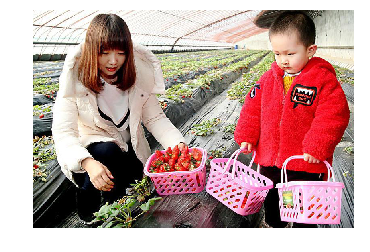

大 棚里 有 两个 蹲 着 的 女人 在 摘 草莓 </S> 0.0567289
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.3512750961830443, 0.5078176117320574, 0.8294710216567971, 0.9854766681468777, 0.7721131547018331, 0.943113828155086, 0.4435788329395431, 0.7474529179468832, 0.9879093507487436, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/usr/local/lib/python2.7/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


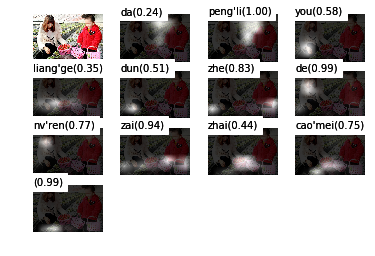

beam search using time(ms): 2676.16701126
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 女人 在 摘 草莓 </S> 0.0273631
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.493607048235097, 0.8871196684141763, 0.4313841454421226, 0.6821754660829353, 0.9936866145998334, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


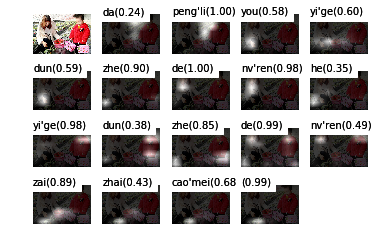

beam search using time(ms): 1529.77800369
两个 手里 拎 着 篮子 的 孩子 蹲 在 大 棚里 </S> 0.0214495
probs [0.16799953869456993, 0.23851947642109161, 0.48824627595350256, 0.9995187454111142, 0.8782026964655993, 0.9684015511331788, 0.36113680879293114, 0.7459812900145011, 0.9963434422232262, 0.5159201951933264, 0.9980734818562016, 0.34115435149538675, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


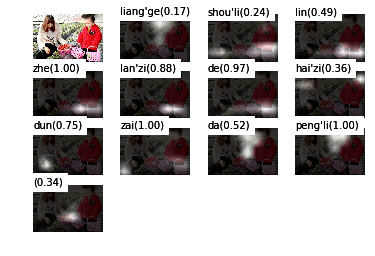

beam search using time(ms): 1027.95100212
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 孩子 在 摘 草莓 </S> 0.0177435
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.18229980606292928, 0.9116233858583466, 0.4566216448006342, 0.6954535003142964, 0.9941453018525085, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


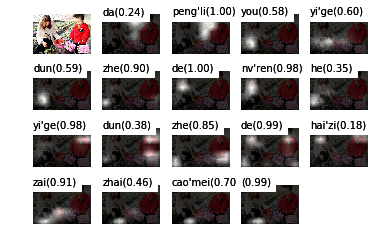

beam search using time(ms): 1521.42000198
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 小孩 在 摘 草莓 </S> 0.0148817
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.12676888757946914, 0.9100371765006952, 0.45766305554884773, 0.6958744095158537, 0.9940033520498759, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


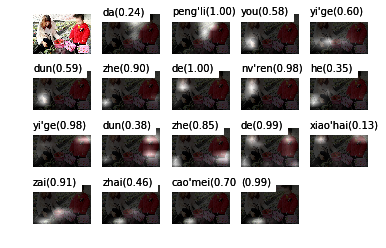

beam search using time(ms): 1492.27595329
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 女孩 在 摘 草莓 </S> 0.0130639
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.09768587493565321, 0.9116213074709216, 0.45428682886284977, 0.6945338894397419, 0.9938707452587701, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


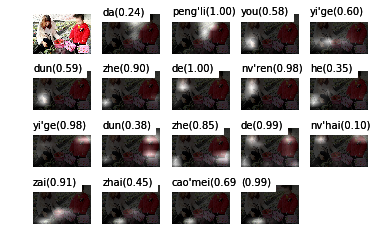

beam search using time(ms): 1587.86892891
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 女人 在 采摘 草莓 </S> 0.0113886
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.493607048235097, 0.8871196684141763, 0.09326737700674148, 0.5179295709279303, 0.9950913334239111, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


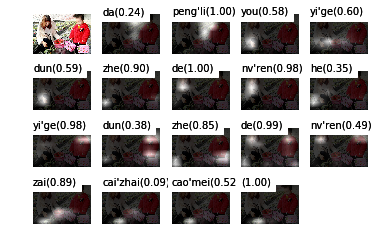

beam search using time(ms): 1550.62913895
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 在 地上 的 女人 在 摘 草莓 </S> 0.0103616
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.14893232691598876, 0.9088534209486653, 0.9058233341459199, 0.4691180730327547, 0.7301762486577217, 0.4663355926539275, 0.6601460173750191, 0.9949626846032418, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


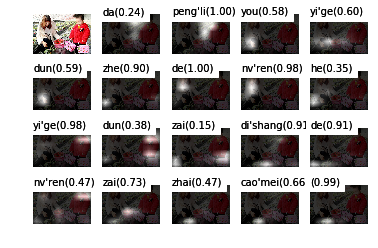

beam search using time(ms): 1713.02390099
大 棚里 有 一个 蹲 着 的 女人 和 一个 蹲 着 的 女人 在 摘 蔬菜 </S> 0.00975496
probs [0.2390876610567242, 0.9952785830118606, 0.5790917958351661, 0.602365776430112, 0.5861856260553129, 0.8992680549536533, 0.996059982292796, 0.9750397232924245, 0.3501393947653874, 0.9755833422225891, 0.3849289388814653, 0.848541039223593, 0.9946078328544384, 0.493607048235097, 0.8871196684141763, 0.4313841454421226, 0.08139509578592755, 0.9951639345037246, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


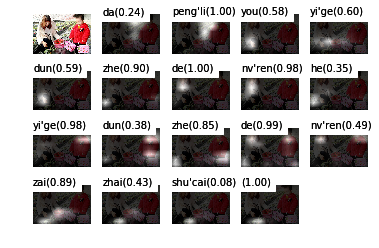

beam search using time(ms): 1631.80994987
一个 右手 拎 着 篮子 的 女人 和 一个 穿着 红色 上衣 的 孩子 蹲 在 大 棚里 摘 草莓 </S> 0.00829206
probs [0.2781096062440911, 0.14269089916826336, 0.4985724532220963, 0.9964300740136933, 0.9382211395750938, 0.9847626425103096, 0.7436815429070276, 0.8553318425280821, 0.9767189115517627, 0.291670120747901, 0.691059592842941, 0.4786576399761212, 0.9945656166684357, 0.3728201417998603, 0.6074418145799791, 0.9966135653558478, 0.5345760578513855, 0.9981776367608112, 0.32303976597566764, 0.83228838149853, 0.996395040855793, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


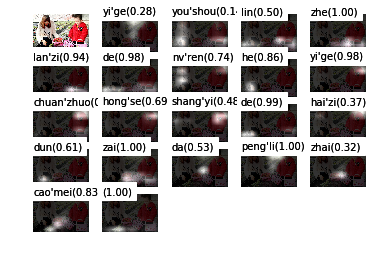

beam search using time(ms): 2430.84216118
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: file:///data2/data/ai_challenger/ai_challenger_caption_test1_20170923/caption_test1_images_20170923/90ea0fa521388ce7bf303f64be77d8f1906dd364.jpg


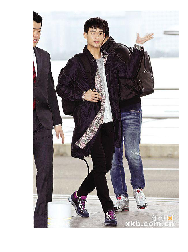

两个 戴着 墨镜 的 人 走 在 平坦 的 道路 上 </S> 0.0563627
probs [0.20481658033015174, 0.25320154457198996, 0.6316657684026596, 0.9377218091272478, 0.6045115380081558, 0.6130788348087712, 0.9986654472633375, 0.45648873743759627, 0.9976115190879261, 0.9162574291231085, 0.9997852309911813, 0.9983523857176403, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


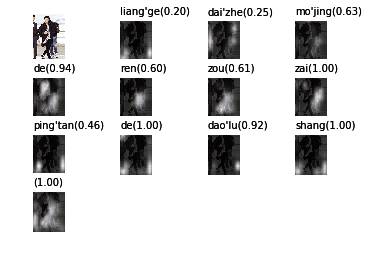

beam search using time(ms): 1838.752985
一个 戴着 帽子 的 男人 和 一个 右肩 背着 包 的 女人 走 在 道路 上 </S> 0.0540232
probs [0.47973177932678635, 0.14932859242156116, 0.5108084467286568, 0.9771460155677831, 0.609482185032423, 0.9208393509605518, 0.9405987879367547, 0.2706207844412316, 0.74870577948405, 0.9940377461170722, 0.9977630460590454, 0.8921027422713134, 0.9787801654739733, 0.9989006696725168, 0.8175246290690589, 0.9992975166516671, 0.9876911379193971, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


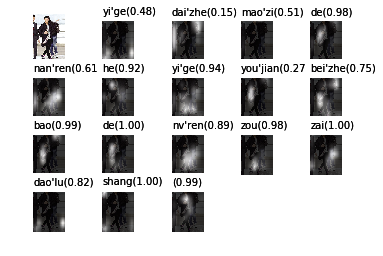

beam search using time(ms): 1436.11502647
一个 右肩 背着 包 的 男人 和 一个 右肩 背着 包 的 女人 走 在 道路 上 </S> 0.0409753
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.40855015723780336, 0.9247050507569935, 0.9590111882925808, 0.18315405852677186, 0.7668312572815574, 0.9894320788392855, 0.9980055612059309, 0.9101693884970937, 0.9819207630384704, 0.9988078993570564, 0.8221673495630971, 0.9993188255774135, 0.9888457607427397, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


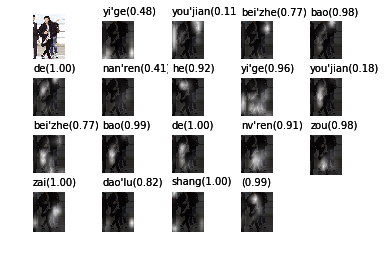

beam search using time(ms): 1370.21207809
一个 右肩 背着 包 的 女人 和 一个 戴着 帽子 的 男人 走 在 道路 上 </S> 0.0402786
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.5196156437443005, 0.8918301635569127, 0.955967593589397, 0.28413398772353793, 0.590477457892656, 0.9978647622869252, 0.6819495919345343, 0.9670945393994205, 0.999261686330436, 0.8012951981320815, 0.9993490644429354, 0.9871610118493169, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


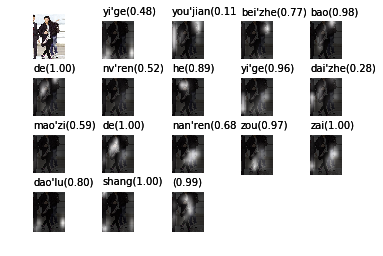

beam search using time(ms): 1254.75287437
一个 戴着 墨镜 的 男人 和 一个 右肩 背着 包 的 女人 走 在 道路 上 </S> 0.0378191
probs [0.47973177932678635, 0.14932859242156116, 0.33401765374283654, 0.9738609050125457, 0.44135911034886655, 0.907868033976625, 0.946479386880303, 0.27409754543884757, 0.7521571680402985, 0.9945104347863946, 0.9977231722703983, 0.8960306942596954, 0.9798479929456898, 0.9989126835064476, 0.8269722473199995, 0.9993044211294042, 0.9876810204414876, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


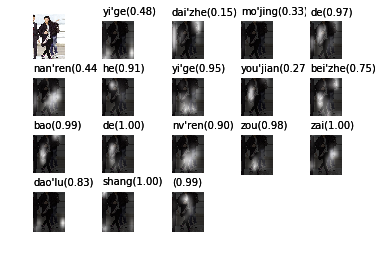

beam search using time(ms): 1266.12615585
一个 右肩 背着 包 的 男人 和 一个 戴着 帽子 的 女人 走 在 道路 上 </S> 0.0288923
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.40855015723780336, 0.9247050507569935, 0.9590111882925808, 0.180897030133809, 0.5119047231670649, 0.9980608943786528, 0.7663928268326051, 0.9664557705699208, 0.99918610586699, 0.8055070881798517, 0.9992877553263335, 0.9865625292979742, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


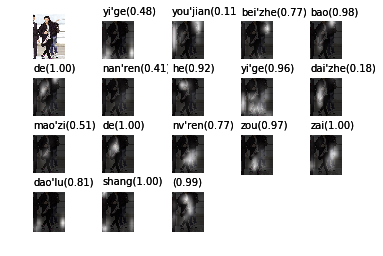

beam search using time(ms): 1286.69190407
一个 右肩 背着 包 的 女人 和 一个 戴着 墨镜 的 男人 走 在 道路 上 </S> 0.0277386
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.5196156437443005, 0.8918301635569127, 0.955967593589397, 0.28413398772353793, 0.3067303369243421, 0.9977555694280614, 0.6076382295901386, 0.9711932629222698, 0.9992587105132325, 0.8084806869687748, 0.9993565648814161, 0.9870705247055732, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


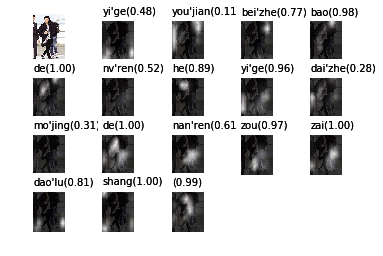

beam search using time(ms): 1338.13810349
一个 右肩 背着 包 的 男人 和 一个 戴着 墨镜 的 女人 走 在 道路 上 </S> 0.0263731
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.40855015723780336, 0.9247050507569935, 0.9590111882925808, 0.180897030133809, 0.37767235704566426, 0.9980110229902215, 0.8559541226126725, 0.9687919840692155, 0.9992377612133292, 0.8104055191018512, 0.9992954929154196, 0.9864146169004325, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


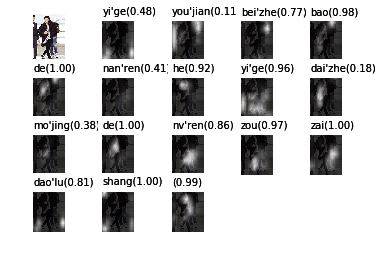

beam search using time(ms): 1268.67103577
一个 右肩 背着 包 的 女人 和 一个 戴着 帽子 的 女人 走 在 道路 上 </S> 0.0240931
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.5196156437443005, 0.8918301635569127, 0.955967593589397, 0.28413398772353793, 0.590477457892656, 0.9978647622869252, 0.23823806326129493, 0.966194846802091, 0.9992107426934044, 0.8082450399671204, 0.9993128732625399, 0.9877364944511421, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


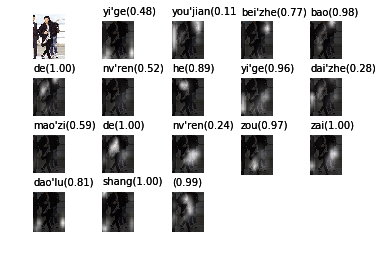

beam search using time(ms): 1535.20488739
一个 右肩 背着 包 的 女人 和 一个 穿着 牛仔裤 的 男人 走 在 道路 上 </S> 0.0235662
probs [0.47973177932678635, 0.1057250489029656, 0.7656565358377128, 0.984141314972535, 0.9960262761221794, 0.5196156437443005, 0.8918301635569127, 0.955967593589397, 0.1694007787308642, 0.300930661421318, 0.9970083598062169, 0.7547390291935859, 0.9747880769195646, 0.9993725186536804, 0.7972099342262885, 0.999470752600702, 0.9864111369838507, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


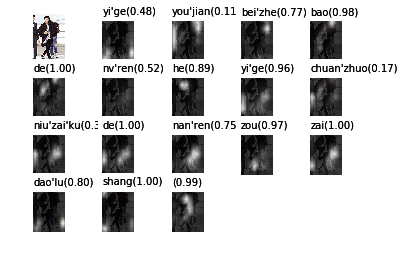

beam search using time(ms): 1968.74594688
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: file:///data2/data/ai_challenger/ai_challenger_caption_validation_20170910/caption_validation_images_20170910/fb36d921dcd9184bdd4659864fe7f3cff47accf5.jpg


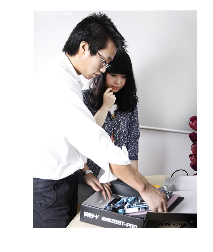

一个 戴着 眼镜 的 男人 和 一个 穿着 裙子 的 女孩 站 在 厨房 里 </S> 0.0138871
probs [0.15392024128170806, 0.4064590345992178, 0.9676249782003564, 0.9979687548339833, 0.9247077032527588, 0.8130794375577075, 0.9809301954173782, 0.30800522534975194, 0.29178046615265485, 0.9987326253410831, 0.5382188123869837, 0.46401418921512655, 0.9970107296660413, 0.7084940121719907, 0.9346241652366634, 0.2924708534624601, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


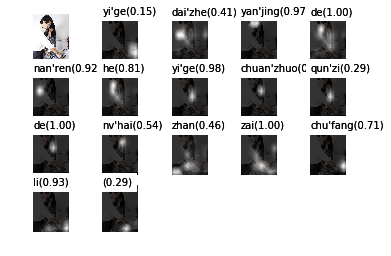

beam search using time(ms): 1976.74107552
厨房 里 有 一个 戴着 眼镜 的 男人 在 教 一个 女孩 使用 电脑 </S> 0.0106763
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.4277749970670171, 0.9718818849212237, 0.9983591583172362, 0.9315050295778757, 0.4129523708450831, 0.618236619372699, 0.9834881395058483, 0.2075838657593482, 0.11838080765915793, 0.41888417967277586, 0.9752837884976071, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


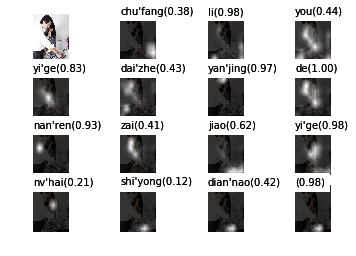

beam search using time(ms): 1155.98392487
厨房 里 有 一个 戴着 眼镜 的 男人 和 一个 穿着 裙子 的 女孩 在 看 同一 台 电脑 </S> 0.0088728
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.4277749970670171, 0.9718818849212237, 0.9983591583172362, 0.9315050295778757, 0.448228199370902, 0.9799970317385915, 0.25227553749562165, 0.29216904142881633, 0.9983832789868282, 0.5873432263057312, 0.9227967323111081, 0.3023320211127331, 0.2640856453124272, 0.8679217772468856, 0.729616293153658, 0.9883537524289985, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


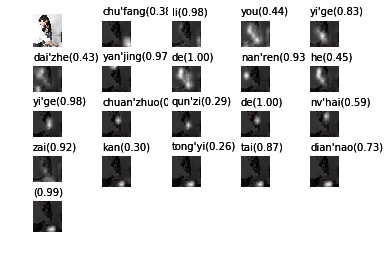

beam search using time(ms): 1488.46006393
厨房 里 有 一个 戴着 眼镜 的 男人 在 教 一个 女孩 使用 机器 </S> 0.00756941
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.4277749970670171, 0.9718818849212237, 0.9983591583172362, 0.9315050295778757, 0.4129523708450831, 0.618236619372699, 0.9834881395058483, 0.2075838657593482, 0.11838080765915793, 0.2131587779397302, 0.974051218609374, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


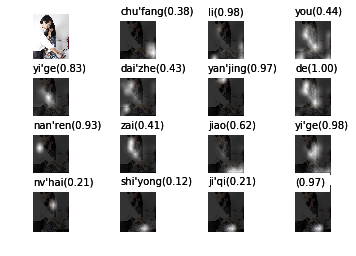

beam search using time(ms): 1126.96290016
厨房 里 有 一个 穿着 白色 上衣 的 男人 和 一个 戴着 眼镜 的 女人 在 看 同一 台 电脑 </S> 0.00705646
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.17617621787659837, 0.7471022895000308, 0.6720113953854048, 0.9979434669679934, 0.9022698944571105, 0.42659670622677376, 0.9788901550214236, 0.3157390543825914, 0.6408957877111112, 0.9968892844465207, 0.7208165704287972, 0.8614018821622175, 0.28956800606726585, 0.22831182898820748, 0.8972226224830744, 0.7507256768846958, 0.98854814389176, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


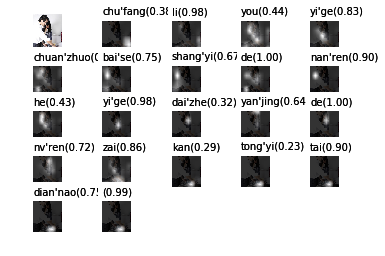

beam search using time(ms): 1521.63100243
厨房 里 有 一个 戴着 眼镜 的 男人 和 一个 穿着 裙子 的 女人 在 看 同一 台 电脑 </S> 0.00681872
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.4277749970670171, 0.9718818849212237, 0.9983591583172362, 0.9315050295778757, 0.448228199370902, 0.9799970317385915, 0.25227553749562165, 0.29216904142881633, 0.9983832789868282, 0.3113631840555131, 0.9198894437531321, 0.3180035584697595, 0.2726961490100322, 0.876193290420947, 0.7211739907317714, 0.9888351534774453, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


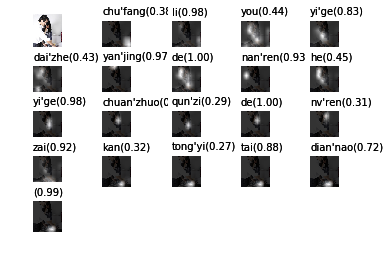

beam search using time(ms): 1577.15010643
一个 戴着 眼镜 的 男人 和 一个 穿着 裙子 的 女孩 站 在 厨房 里 的 桌子 旁 </S> 0.00513584
probs [0.15392024128170806, 0.4064590345992178, 0.9676249782003564, 0.9979687548339833, 0.9247077032527588, 0.8130794375577075, 0.9809301954173782, 0.30800522534975194, 0.29178046615265485, 0.9987326253410831, 0.5382188123869837, 0.46401418921512655, 0.9970107296660413, 0.7084940121719907, 0.9346241652366634, 0.12672525155150244, 0.4966591049797411, 0.8234581854981468, 0.4858672609425442, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


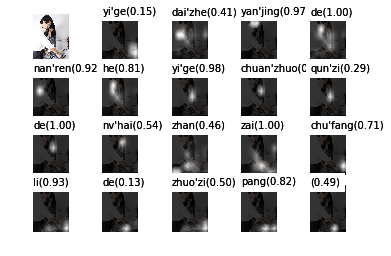

beam search using time(ms): 1392.90499687
厨房 里 有 一个 穿着 白色 上衣 的 男人 和 一个 戴着 眼镜 的 女人 在 制作 食物 </S> 0.00509665
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.17617621787659837, 0.7471022895000308, 0.6720113953854048, 0.9979434669679934, 0.9022698944571105, 0.42659670622677376, 0.9788901550214236, 0.3157390543825914, 0.6408957877111112, 0.9968892844465207, 0.7208165704287972, 0.8614018821622175, 0.08709121717659347, 0.333881543715732, 0.9974376224063943, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


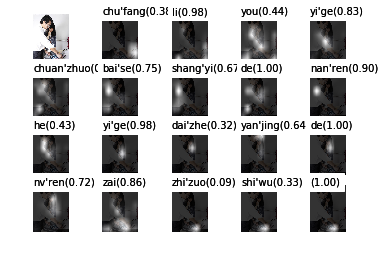

beam search using time(ms): 1375.61702728
厨房 里 有 一个 穿着 白色 上衣 的 男人 和 一个 戴着 眼镜 的 女人 在 看 电脑 </S> 0.00491118
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.17617621787659837, 0.7471022895000308, 0.6720113953854048, 0.9979434669679934, 0.9022698944571105, 0.42659670622677376, 0.9788901550214236, 0.3157390543825914, 0.6408957877111112, 0.9968892844465207, 0.7208165704287972, 0.8614018821622175, 0.28956800606726585, 0.09570635336229172, 0.9686116575558423, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


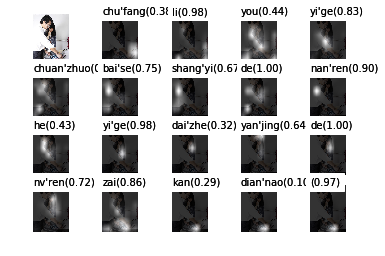

beam search using time(ms): 1840.40689468
厨房 里 有 一个 穿着 白色 上衣 的 男人 和 一个 戴着 眼镜 的 女人 在 制作 东西 </S> 0.00490117
probs [0.38062213620918217, 0.9764272989198802, 0.4366058985770447, 0.8335035413352604, 0.17617621787659837, 0.7471022895000308, 0.6720113953854048, 0.9979434669679934, 0.9022698944571105, 0.42659670622677376, 0.9788901550214236, 0.3157390543825914, 0.6408957877111112, 0.9968892844465207, 0.7208165704287972, 0.8614018821622175, 0.08709121717659347, 0.30730403079067325, 0.9987294149603017, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


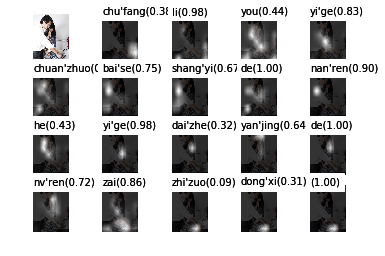

beam search using time(ms): 1371.59204483
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: file:///data2/data/ai_challenger/ai_challenger_caption_validation_20170910/caption_validation_images_20170910/fbbf70826ab1b96cead6209c1da44f1a590da23d.jpg


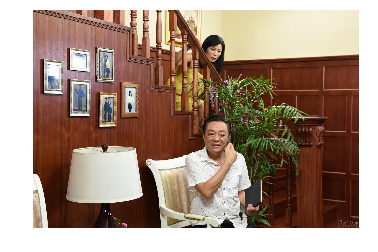

一个 穿着 白色 上衣 的 女人 坐在 房间 里 的 椅子 上 </S> 0.0161114
probs [0.3808986758533966, 0.2990869698590627, 0.3265703556813488, 0.35859716963672555, 0.9788055199339719, 0.3791630675832076, 0.43533412659440807, 0.25396756292756306, 0.9463952447670969, 0.9419772593788314, 0.8625791335568583, 0.9801851723256795, 0.9552500952350281, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


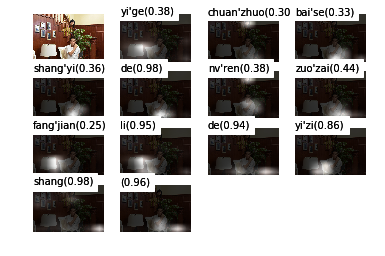

beam search using time(ms): 2166.14508629
房间 里 有 一个 穿着 白色 上衣 的 男人 坐在 椅子 上 </S> 0.014584
probs [0.1409935522149119, 0.9896280621179998, 0.4386479275243513, 0.9270026159342327, 0.2825935070491319, 0.2993829012964626, 0.3773317163252017, 0.9874372195559571, 0.5681423952160202, 0.40881569905612386, 0.8273962372558634, 0.9921754160137739, 0.9566213682063224, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


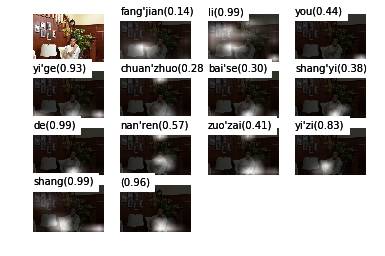

beam search using time(ms): 1392.45581627
房间 里 有 一个 穿着 白色 上衣 的 女人 坐在 椅子 上 </S> 0.0139263
probs [0.1409935522149119, 0.9896280621179998, 0.4386479275243513, 0.9270026159342327, 0.2825935070491319, 0.2993829012964626, 0.3773317163252017, 0.9874372195559571, 0.3688739152472677, 0.573777994691586, 0.8226716920579834, 0.9887578789593362, 0.9705830965556357, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


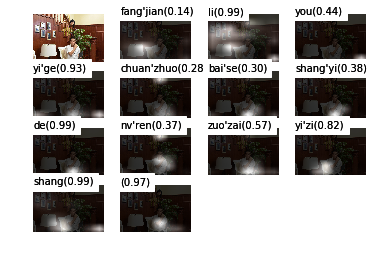

beam search using time(ms): 1410.16411781
一个 穿着 裙子 的 女人 和 一个 穿着 西装 的 男人 坐在 室内 的 椅子 上 </S> 0.00786813
probs [0.3808986758533966, 0.2990869698590627, 0.1459566137490998, 0.983740146343956, 0.9642893932776289, 0.3863953861365948, 0.985303619931292, 0.5757436378120907, 0.1773562342910417, 0.9938595588105696, 0.9862606028420119, 0.6953612544305888, 0.18859043899702588, 0.9592069293145683, 0.8428738048395815, 0.9826178973253085, 0.8526575654849946, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


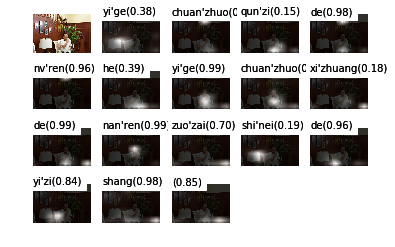

beam search using time(ms): 1754.43601608
房间 里 有 一个 坐在 椅子 上 的 男人 和 一个 坐在 椅子 上 的 女人 在 交谈 </S> 0.00758517
probs [0.1409935522149119, 0.9896280621179998, 0.4386479275243513, 0.9270026159342327, 0.10778900785476125, 0.8494523692188811, 0.9591156852461087, 0.9829435102653674, 0.7159564842847744, 0.2614426797504398, 0.9799931400218372, 0.14478621200328232, 0.8356081961678418, 0.973796125310439, 0.9954419229886273, 0.837397202276509, 0.8768457605756255, 0.48491457413249506, 0.99906746168228, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


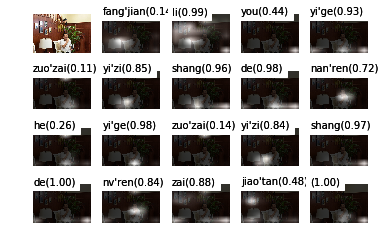

beam search using time(ms): 1963.32097054
一个 穿着 白色 上衣 的 男人 和 一个 穿着 裙子 的 女人 坐在 房间 里 的 椅子 上 </S> 0.00680681
probs [0.3808986758533966, 0.2990869698590627, 0.3265703556813488, 0.35859716963672555, 0.9788055199339719, 0.5245175311163606, 0.4005584206894764, 0.9885610746067386, 0.43170001051061546, 0.3594527234169004, 0.9949976168964529, 0.980846810809708, 0.6697158875080064, 0.21928388602581783, 0.9678873446375825, 0.7100960243712537, 0.8213721505617377, 0.983004787898548, 0.8931536430897408, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


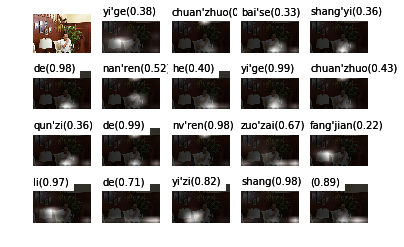

beam search using time(ms): 2097.35608101
一个 穿着 裙子 的 女人 和 一个 穿着 西装 的 男人 坐在 屋子里 的 椅子 上 </S> 0.00676152
probs [0.3808986758533966, 0.2990869698590627, 0.1459566137490998, 0.983740146343956, 0.9642893932776289, 0.3863953861365948, 0.985303619931292, 0.5757436378120907, 0.1773562342910417, 0.9938595588105696, 0.9862606028420119, 0.6953612544305888, 0.17920755411058562, 0.7416767523533794, 0.8368858275318128, 0.9724399108684292, 0.8681349140838913, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


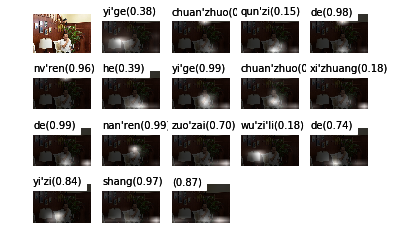

beam search using time(ms): 1959.45382118
一个 穿着 白色 上衣 的 男人 和 一个 穿着 裙子 的 女人 坐在 室内 的 椅子 上 </S> 0.00651567
probs [0.3808986758533966, 0.2990869698590627, 0.3265703556813488, 0.35859716963672555, 0.9788055199339719, 0.5245175311163606, 0.4005584206894764, 0.9885610746067386, 0.43170001051061546, 0.3594527234169004, 0.9949976168964529, 0.980846810809708, 0.6697158875080064, 0.17013797011180337, 0.938800527021337, 0.8538275483508598, 0.9806421384981983, 0.8541919243654826, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


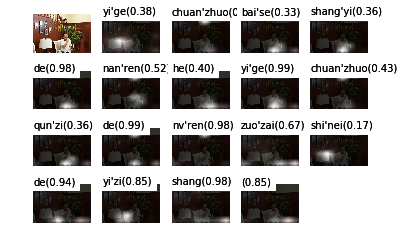

beam search using time(ms): 2194.6439743
一个 穿着 裙子 的 女人 和 一个 穿着 西装 的 男人 坐在 房间 里 的 椅子 上 </S> 0.00643951
probs [0.3808986758533966, 0.2990869698590627, 0.1459566137490998, 0.983740146343956, 0.9642893932776289, 0.3863953861365948, 0.985303619931292, 0.5757436378120907, 0.1773562342910417, 0.9938595588105696, 0.9862606028420119, 0.6953612544305888, 0.14131103759239494, 0.9655409283739325, 0.8009873904052616, 0.8073912733879797, 0.9739821193677742, 0.8539166268737797, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


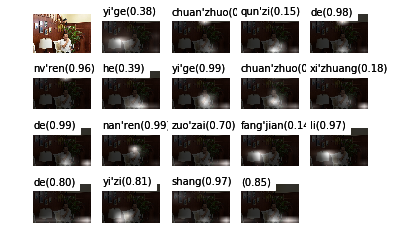

beam search using time(ms): 2655.21216393
一个 穿着 裙子 的 女人 和 一个 穿着 西装 的 男人 坐在 房屋里 的 椅子 上 </S> 0.00608485
probs [0.3808986758533966, 0.2990869698590627, 0.1459566137490998, 0.983740146343956, 0.9642893932776289, 0.3863953861365948, 0.985303619931292, 0.5757436378120907, 0.1773562342910417, 0.9938595588105696, 0.9862606028420119, 0.6953612544305888, 0.14342210753322066, 0.7689039271851065, 0.822594894489504, 0.974284833818294, 0.8577106133983124, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


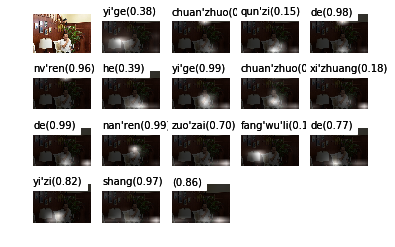

beam search using time(ms): 1924.9060154
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: fd62aeec3e8a41fc52e327bd89883f73b8a302d7


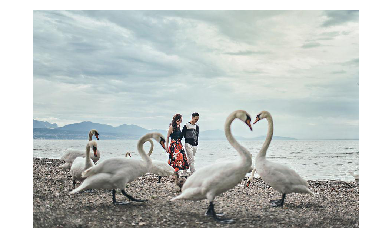

一群 穿着 各异 的 人 站 在 一望无际 的 大 棚里 </S> 0.00409031
probs [0.1494610041700438, 0.12537117094999897, 0.42861108163071115, 0.9851224182653362, 0.8638740079519516, 0.36808614231531545, 0.9937936232940687, 0.23883999763671743, 0.9903011122165978, 0.23373210632369462, 0.34327139886715996, 0.7564340660200723, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


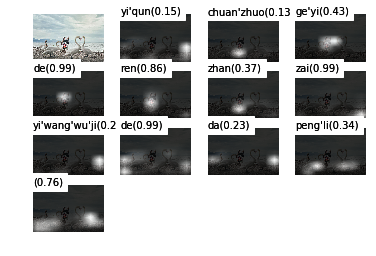

beam search using time(ms): 1815.59991837
一群 穿着 各异 的 人 站 在 一望无际 的 海边 </S> 0.00244725
probs [0.1494610041700438, 0.12537117094999897, 0.42861108163071115, 0.9851224182653362, 0.8638740079519516, 0.36808614231531545, 0.9937936232940687, 0.23883999763671743, 0.9903011122165978, 0.38710096117454745, 0.0766816149698066, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


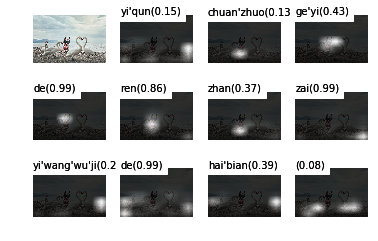

beam search using time(ms): 979.74896431
一群 穿着 各异 的 人 站 在 一望无际 的 海边 看 </S> 0.0012993
probs [0.1494610041700438, 0.12537117094999897, 0.42861108163071115, 0.9851224182653362, 0.8638740079519516, 0.36808614231531545, 0.9937936232940687, 0.23883999763671743, 0.9903011122165978, 0.38710096117454745, 0.5980653844457102, 0.031015934085397906, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


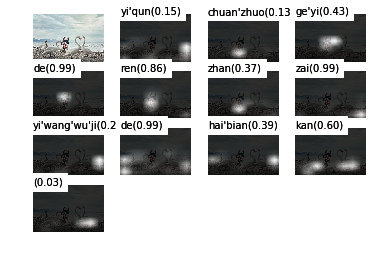

beam search using time(ms): 1065.92702866
一望无际 的 大 海边 有 一个 右手 拿 着 相机 的 男人 在 给 一群 人 拍照 </S> 0.00111817
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.15813815909585188, 0.9777553467843183, 0.5348133958915964, 0.27725166640388493, 0.4022052421649862, 0.7359748995847469, 0.1773883738190094, 0.8501644170811601, 0.999361446246347, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


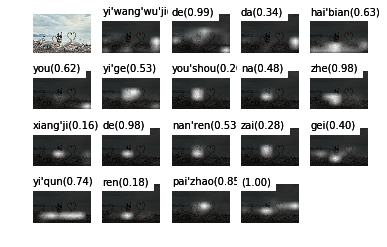

beam search using time(ms): 1565.44613838
一望无际 的 大 海边 有 一个 双手 拿 着 相机 的 男人 站 在 羊群 旁 </S> 0.00108771
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.10486678092617643, 0.3027263119067789, 0.9750686241635996, 0.34077552905947134, 0.9904682018719896, 0.5154724670191733, 0.2882925773753137, 0.9909569334351095, 0.2213794433605526, 0.3625490913777432, 0.8681946685325655, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


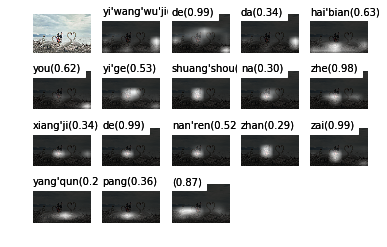

beam search using time(ms): 1507.62701035
一望无际 的 大 海边 有 一个 右手 拿 着 东西 的 女人 站 在 一群 群 的 旁边 </S> 0.00108283
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.1532280372384496, 0.981528867399217, 0.4061108744257077, 0.40675340041665436, 0.992433186056277, 0.6315622388000119, 0.15382491250290092, 0.40716722010490414, 0.8466851892544113, 0.9574149037834755, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


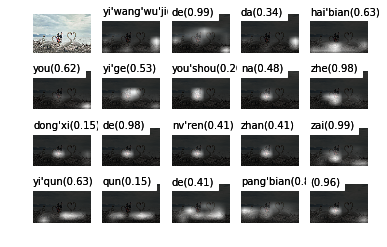

beam search using time(ms): 1781.23092651
一望无际 的 大 海边 有 一个 右手 拿 着 相机 的 男人 站 在 羊群 旁 </S> 0.00107431
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.15813815909585188, 0.9777553467843183, 0.5348133958915964, 0.33692086603501337, 0.9822355645859971, 0.143980802533742, 0.3289405001827443, 0.8874460753051051, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


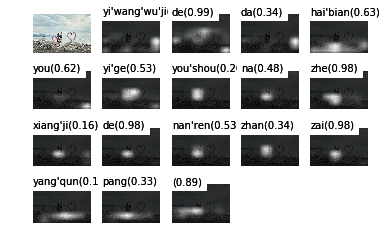

beam search using time(ms): 1593.13488007
一望无际 的 大 海边 有 一个 右手 拿 着 东西 的 男人 站 在 一群 群 的 旁边 </S> 0.000961265
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.1532280372384496, 0.981528867399217, 0.42362927674409934, 0.36135820111032496, 0.988650087075233, 0.5200217768779591, 0.15386727763396466, 0.4337044884101529, 0.8150181817092921, 0.9577291628100035, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


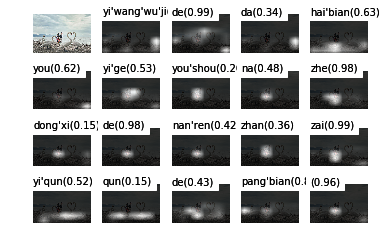

beam search using time(ms): 1692.89016724
一望无际 的 大 海边 有 一个 右手 拿 着 东西 的 女人 站 在 一群 鹅 旁 </S> 0.000955217
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.1532280372384496, 0.981528867399217, 0.4061108744257077, 0.40675340041665436, 0.992433186056277, 0.6315622388000119, 0.0978637403399123, 0.5028865179940076, 0.9648930024183854, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


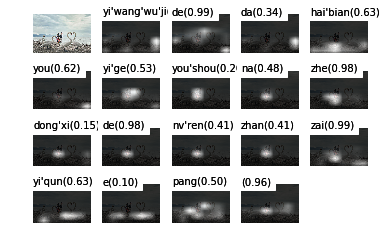

beam search using time(ms): 1638.44895363
一望无际 的 大 海边 有 一个 右手 拿 着 相机 的 男人 站 在 一群 群 的 旁边 </S> 0.000935605
probs [0.13085297480041228, 0.9926419888984936, 0.337680501223807, 0.6281768683947906, 0.6160133158120129, 0.5278510334053338, 0.19610141499673006, 0.4750855855243498, 0.9756383729998819, 0.15813815909585188, 0.9777553467843183, 0.5348133958915964, 0.33692086603501337, 0.9822355645859971, 0.4167203914941789, 0.1489649270420218, 0.4743934771232869, 0.7875174916928651, 0.9181335493641651, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


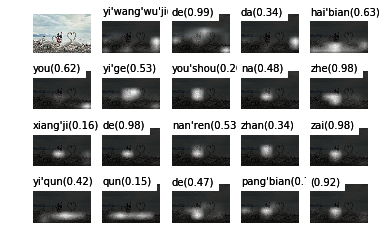

beam search using time(ms): 2113.81101608
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 6275b5349168ac3fab6a493c509301d023cf39d3


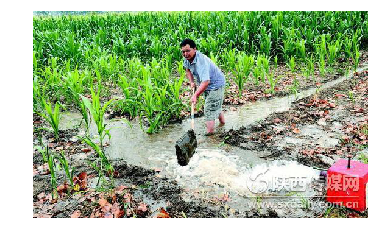

一个 双手 拿 着 鱼 的 男人 站 在 水田 里 </S> 0.0438953
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.13628965378883431, 0.8740401237032898, 0.9640430425569978, 0.7393677114260663, 0.999073411081539, 0.25157897412673697, 0.9782398233700511, 0.6924996852312137, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


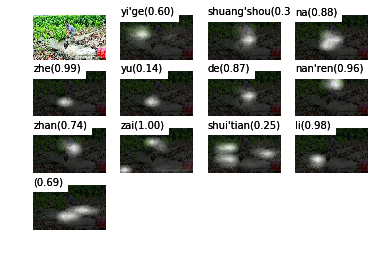

beam search using time(ms): 1497.0870018
一个 双手 拿 着 渔网 的 男人 站 在 水田 里 </S> 0.0427956
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.14449936147795434, 0.952476047707468, 0.9596729753938444, 0.6752530493843435, 0.9990523505826038, 0.2515575617847594, 0.9783639554499041, 0.6288468427791558, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


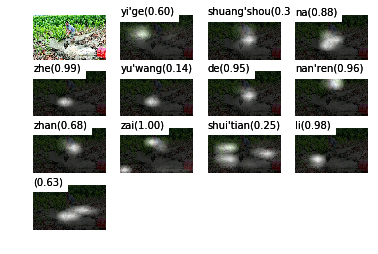

beam search using time(ms): 819.271087646
一个 双手 拿 着 网兜 的 男人 站 在 水田 里 </S> 0.0396778
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.11532530360933295, 0.984567656693356, 0.9631064417470726, 0.6981875382785496, 0.9990058302468936, 0.24666691436791124, 0.9795785289179255, 0.6499815017266048, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


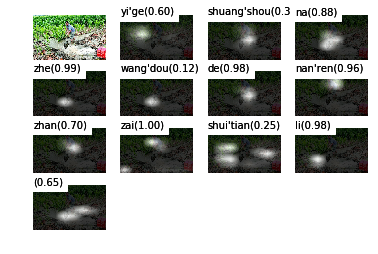

beam search using time(ms): 779.831886292
一个 双手 拿 着 东西 的 男人 站 在 水田 里 </S> 0.0349166
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.08610563818125475, 0.9861949762882506, 0.9620638495345925, 0.7153266109952469, 0.9990030938377003, 0.23916776360357872, 0.9792367356305707, 0.6906386937915138, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


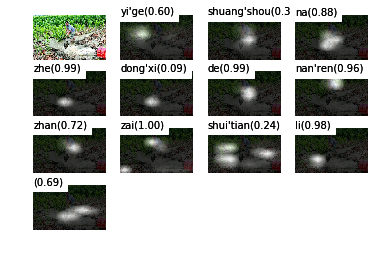

beam search using time(ms): 842.458963394
一个 双手 拿 着 秧苗 的 男人 站 在 水田 里 </S> 0.0345292
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.10328903099692217, 0.9856211720587962, 0.9629009264523954, 0.6534292103050575, 0.9990638921178833, 0.26095715353113824, 0.9788203660983229, 0.5658249159601692, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


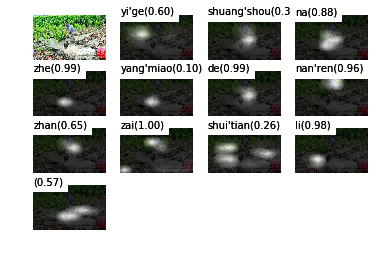

beam search using time(ms): 851.089000702
一个 双手 拿 着 鱼 的 男人 站 在 田地 里 </S> 0.0268173
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.13628965378883431, 0.8740401237032898, 0.9640430425569978, 0.7393677114260663, 0.999073411081539, 0.10630198815236667, 0.9698818474256587, 0.6606539562970682, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


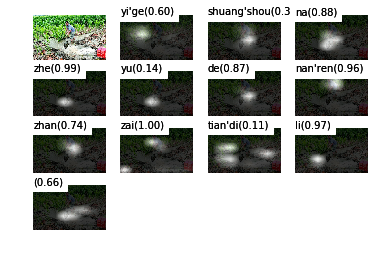

beam search using time(ms): 797.828197479
一个 双手 拿 着 渔网 的 男人 站 在 田地 里 </S> 0.0264982
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.14449936147795434, 0.952476047707468, 0.9596729753938444, 0.6752530493843435, 0.9990523505826038, 0.11197065491661277, 0.9708593177720599, 0.5833783167671431, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


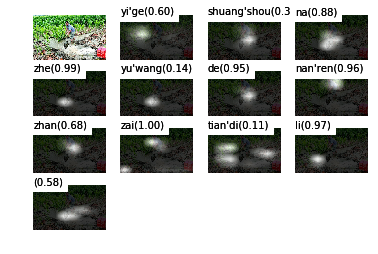

beam search using time(ms): 766.822814941
一个 双手 拿 着 网兜 的 男人 站 在 田地 里 </S> 0.0255759
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.11532530360933295, 0.984567656693356, 0.9631064417470726, 0.6981875382785496, 0.9990058302468936, 0.11706139660093987, 0.9722910180560983, 0.6093653291595195, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


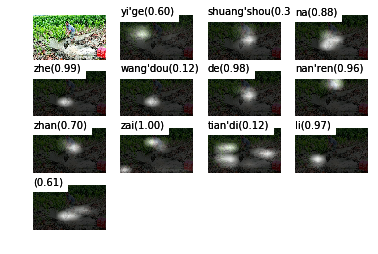

beam search using time(ms): 778.849124908
一个 双手 拿 着 藕 的 男人 站 在 水田 里 </S> 0.023703
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.058827569508840494, 0.8710813141990549, 0.9645109173423, 0.6819876186029675, 0.999157900038544, 0.27633934435952984, 0.9781973872633353, 0.5043984455118877, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


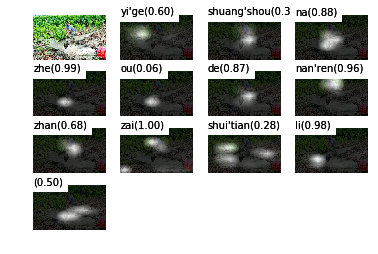

beam search using time(ms): 788.912057877
一个 双手 拿 着 秧苗 的 男人 站 在 田地 里 </S> 0.0213594
probs [0.6012404549319614, 0.3905022434398857, 0.8809240394329368, 0.9943895976545473, 0.10328903099692217, 0.9856211720587962, 0.9629009264523954, 0.6534292103050575, 0.9990638921178833, 0.1194999603389865, 0.972173154108116, 0.5088622748273043, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


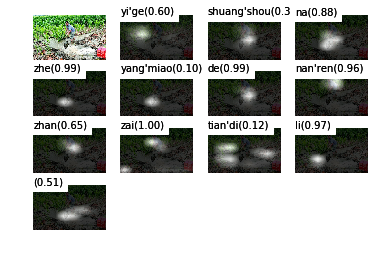

beam search using time(ms): 796.360969543
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: e427db58e8825be469174d1c88cf223104cfc191


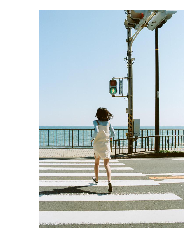

一个 穿着 白色 上衣 的 女人 在 道路 上 奔跑 </S> 0.0217291
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.2465167594120575, 0.9564882949375937, 0.3793185866427448, 0.5322974505507335, 0.509759575573337, 0.9875943918826802, 0.34481369268605294, 0.936916931378597, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


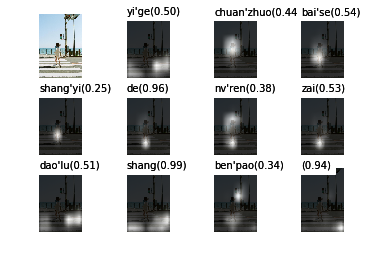

beam search using time(ms): 1908.91313553
一个 穿着 白色 上衣 的 女人 在 道路 上 跑步 </S> 0.0191205
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.2465167594120575, 0.9564882949375937, 0.3793185866427448, 0.5322974505507335, 0.509759575573337, 0.9875943918826802, 0.2562386464173132, 0.9988234787911795, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


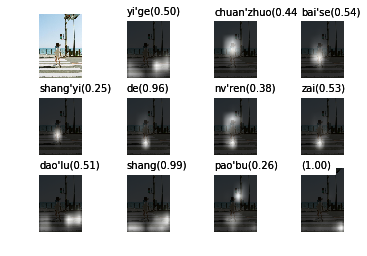

beam search using time(ms): 1105.26299477
一个 穿着 白色 衣服 的 人 在 宽阔 的 道路 上 跑步 </S> 0.0186071
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.35786146086669696, 0.9557722999722271, 0.36475868104442316, 0.5129961973320191, 0.200351970735633, 0.9175767748414922, 0.6215837209568286, 0.9950696143239715, 0.5897733053912276, 0.9981145711090437, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


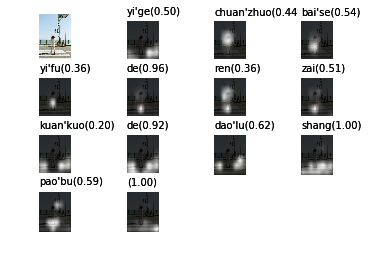

beam search using time(ms): 1665.06695747
一个 穿着 白色 衣服 的 女人 在 道路 上 奔跑 </S> 0.0169917
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.35786146086669696, 0.9557722999722271, 0.3924291864634893, 0.4056525971463201, 0.3331894324431948, 0.9797779514117013, 0.32842521714782313, 0.8475503975038957, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


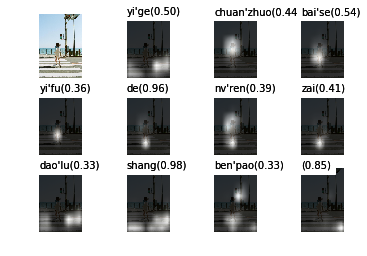

beam search using time(ms): 1101.15003586
一个 穿着 白色 衣服 的 女人 在 道路 上 跑步 </S> 0.0168511
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.35786146086669696, 0.9557722999722271, 0.3924291864634893, 0.4056525971463201, 0.3331894324431948, 0.9797779514117013, 0.2746158351453242, 0.9984015782995244, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


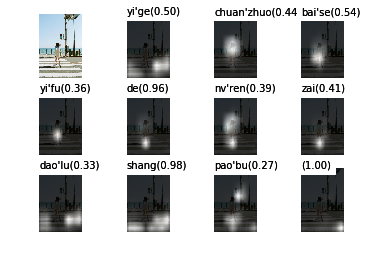

beam search using time(ms): 1082.4739933
一个 穿着 白色 短袖 的 女人 在 道路 上 奔跑 </S> 0.0150364
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.14254334502194366, 0.9236292819812469, 0.4436747388601793, 0.6046417705819138, 0.42667797912348476, 0.9852429798551139, 0.289538631721228, 0.9212046093958488, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


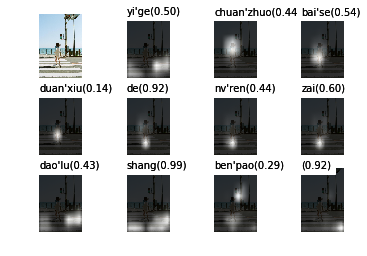

beam search using time(ms): 1103.97195816
一个 穿着 白色 衣服 的 人 在 宽阔 的 道路 上 奔跑 </S> 0.0108196
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.35786146086669696, 0.9557722999722271, 0.36475868104442316, 0.5129961973320191, 0.200351970735633, 0.9175767748414922, 0.6215837209568286, 0.9950696143239715, 0.26720188416530805, 0.7868904627630658, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


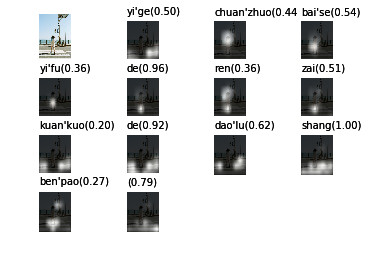

beam search using time(ms): 1292.19889641
道路 上 有 一个 穿着 白色 衣服 的 人 在 跑步 </S> 0.00783878
probs [0.06441089969941825, 0.9963177633752164, 0.5074562461999796, 0.9084518454774502, 0.5414515620483431, 0.5127408210266083, 0.35274484316329213, 0.9712381286803671, 0.3675756539686396, 0.9022455326831295, 0.12939106942813494, 0.997419239857832, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


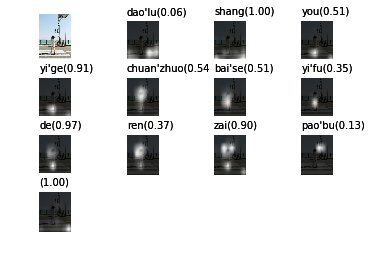

beam search using time(ms): 1207.25417137
一个 穿着 白色 衣服 的 女人 在 道路 上 奔跑 着 </S> 0.00725455
probs [0.5037666754606521, 0.4415842508976649, 0.543661598888842, 0.35786146086669696, 0.9557722999722271, 0.3924291864634893, 0.4056525971463201, 0.3331894324431948, 0.9797779514117013, 0.32842521714782313, 0.149576699982794, 0.9873499365176167, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


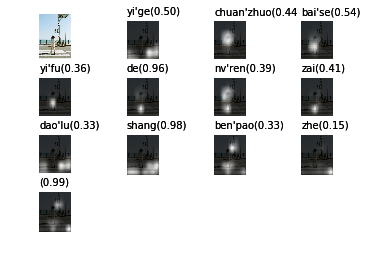

beam search using time(ms): 1206.99000359
道路 上 有 一个 穿着 白色 衣服 的 女人 在 玩 滑板 </S> 0.00713824
probs [0.06441089969941825, 0.9963177633752164, 0.5074562461999796, 0.9084518454774502, 0.5414515620483431, 0.5127408210266083, 0.35274484316329213, 0.9712381286803671, 0.3383786337596363, 0.8970030126072011, 0.1573733601367727, 0.6289634794370601, 0.9937617185073662, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


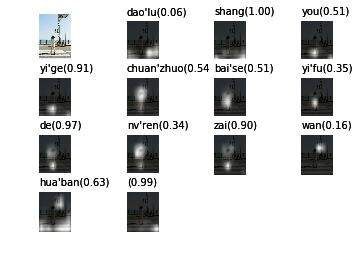

beam search using time(ms): 1330.5618763
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: f995df1c46fbd6e930e6f67838d2beed78a5ad56.jpg


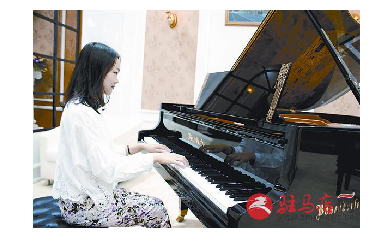

房间 里 有 一个 穿着 白色 裙子 的 女人 在 弹钢琴 </S> 0.081056
probs [0.17036968765830596, 0.9923580480811707, 0.7913112310069882, 0.9788380694819334, 0.5445491760018444, 0.7467979391888102, 0.46933602852316303, 0.9915182167970259, 0.5473302800833688, 0.7208071398890579, 0.9532105061925601, 0.999123388771651, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


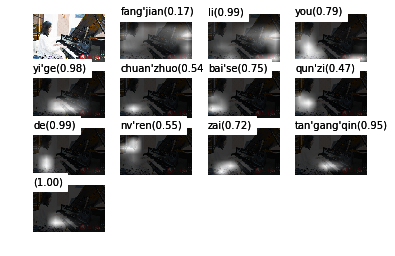

beam search using time(ms): 5557.83295631
房间 里 有 一个 坐在 凳子 上 的 女人 在 弹钢琴 </S> 0.0736561
probs [0.17036968765830596, 0.9923580480811707, 0.7913112310069882, 0.9788380694819334, 0.17171741760926396, 0.6500016478354025, 0.987691951994995, 0.9908490125516475, 0.5786374945737297, 0.9935296159195918, 0.9480138857309437, 0.9994464602194297, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


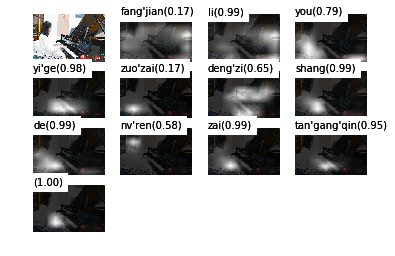

beam search using time(ms): 1448.48513603
屋子里 有 一个 坐在 凳子 上 的 女人 在 弹钢琴 </S> 0.0711528
probs [0.1284712527505624, 0.8829706614887017, 0.9878853852571652, 0.22752287122504844, 0.6096098730535606, 0.984500868314576, 0.9926290681291299, 0.5791004250396543, 0.9943052059724432, 0.9292148661085943, 0.9993759714074631, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


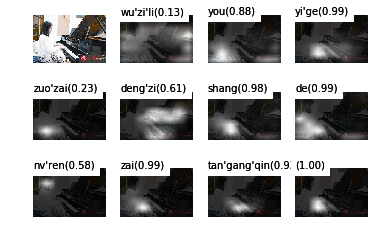

beam search using time(ms): 1268.44501495
屋子里 有 一个 穿着 白色 裙子 的 女人 在 弹钢琴 </S> 0.0668838
probs [0.1284712527505624, 0.8829706614887017, 0.9878853852571652, 0.4891222959060154, 0.6949435551423515, 0.47745469387649053, 0.9920924558912728, 0.5141005703698664, 0.8325381717265189, 0.9407216708550876, 0.9988445296978753, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


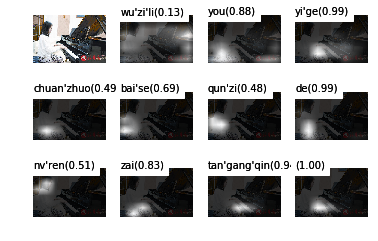

beam search using time(ms): 1501.91688538
房间 里 有 一个 穿着 白色 裙子 的 女孩 在 弹钢琴 </S> 0.0657422
probs [0.17036968765830596, 0.9923580480811707, 0.7913112310069882, 0.9788380694819334, 0.5445491760018444, 0.7467979391888102, 0.46933602852316303, 0.9915182167970259, 0.3624214010754281, 0.7335119643053393, 0.9579945061609902, 0.9991545678445785, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


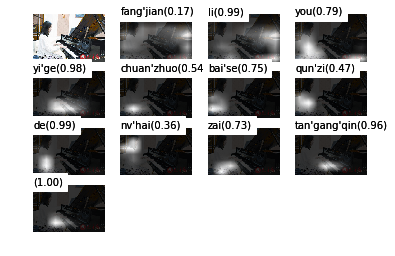

beam search using time(ms): 1465.24310112
室内 有 一个 穿着 白色 裙子 的 女人 在 弹钢琴 </S> 0.0616887
probs [0.20610507089127478, 0.6257866019344956, 0.9121891278724059, 0.5210375052313131, 0.7257072257022796, 0.43404864736135634, 0.9911420439674884, 0.5328008215254252, 0.6489728838415805, 0.947630919316099, 0.9986995702606475, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


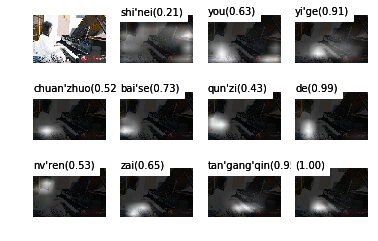

beam search using time(ms): 9093.66393089
屋子里 有 一个 穿着 白色 裙子 的 女孩 在 弹钢琴 </S> 0.0595327
probs [0.1284712527505624, 0.8829706614887017, 0.9878853852571652, 0.4891222959060154, 0.6949435551423515, 0.47745469387649053, 0.9920924558912728, 0.40856152954050545, 0.8422012198109731, 0.9465325732082641, 0.998882709021298, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


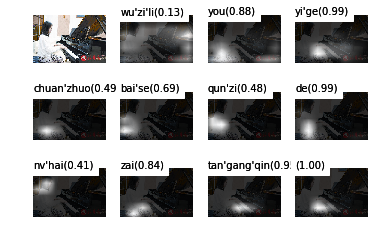

beam search using time(ms): 1072.89004326
房间 里 有 一个 坐在 凳子 上 的 女孩 在 弹钢琴 </S> 0.0562655
probs [0.17036968765830596, 0.9923580480811707, 0.7913112310069882, 0.9788380694819334, 0.17171741760926396, 0.6500016478354025, 0.987691951994995, 0.9908490125516475, 0.34798849461475617, 0.9935340874252796, 0.954882891502324, 0.9994582490184258, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


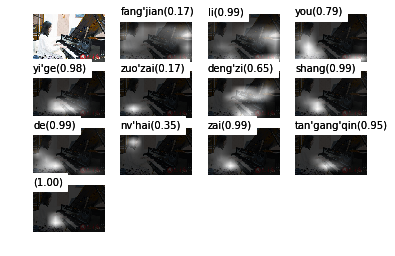

beam search using time(ms): 1355.22985458
室内 有 一个 穿着 白色 裙子 的 女孩 在 弹钢琴 </S> 0.0518666
probs [0.20610507089127478, 0.6257866019344956, 0.9121891278724059, 0.5210375052313131, 0.7257072257022796, 0.43404864736135634, 0.9911420439674884, 0.37834671341020154, 0.6616047138433879, 0.9544141015188418, 0.9987925582966121, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


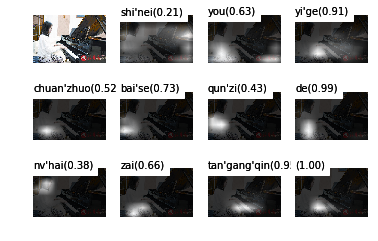

beam search using time(ms): 1205.37805557
房间 里 有 一个 穿着 白色 裙子 的 女人 坐在 凳子 上 弹钢琴 </S> 0.0354888
probs [0.17036968765830596, 0.9923580480811707, 0.7913112310069882, 0.9788380694819334, 0.5445491760018444, 0.7467979391888102, 0.46933602852316303, 0.9915182167970259, 0.5473302800833688, 0.2694461550184384, 0.5398948877220564, 0.9456124031761057, 0.8409928788894847, 0.9993326352240679, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


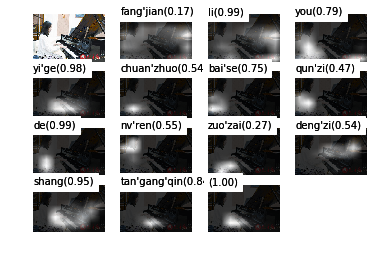

beam search using time(ms): 1286.21697426
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: fceb0da46724071949b6e9a37ace235a0b1a43ff.jpg


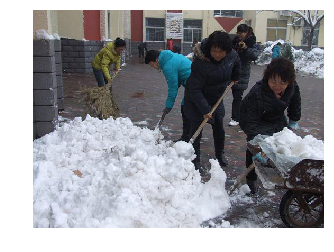

一群 手里 拿 着 工具 的 人 在 道路 上 清理 积雪 </S> 0.0584964
probs [0.20304804199893023, 0.2499867075652781, 0.993478196207168, 0.9949358965189269, 0.5583211125821037, 0.9688644922228897, 0.9458336393103187, 0.8212143753874522, 0.5146128970077324, 0.9810887441999412, 0.48298883310952856, 0.8946148039100689, 0.9916070587154177, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


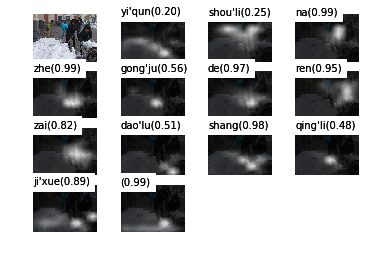

beam search using time(ms): 2852.89907455
道路 上 有 一群 拿 着 工具 的 人 在 清理 积雪 </S> 0.0459428
probs [0.08804671336910896, 0.993372078628127, 0.645010013756327, 0.6892700302663615, 0.3461682897950223, 0.9913372995902973, 0.5271262922293343, 0.9604458498525174, 0.9601381534096987, 0.9732815978428558, 0.5081338927250633, 0.9246364605478145, 0.9718092631794789, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


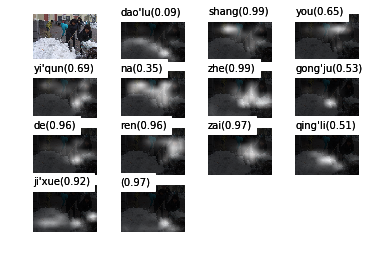

beam search using time(ms): 1479.13503647
一群 手里 拿 着 铁锹 的 人 在 道路 上 清理 积雪 </S> 0.040548
probs [0.20304804199893023, 0.2499867075652781, 0.993478196207168, 0.9949358965189269, 0.28294336881915594, 0.9790459887784365, 0.952774413529938, 0.8148929185773878, 0.5076311025294692, 0.9804095920639011, 0.4769689834550725, 0.8951008835459177, 0.9917281580682411, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


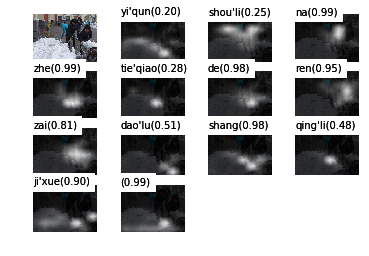

beam search using time(ms): 1445.7681179
道路 上 有 一群 拿 着 铁锹 的 人 在 清理 积雪 </S> 0.039309
probs [0.08804671336910896, 0.993372078628127, 0.645010013756327, 0.6892700302663615, 0.3461682897950223, 0.9913372995902973, 0.40255382107979915, 0.9731708318467621, 0.9624373749856755, 0.972229716516592, 0.4886790068526191, 0.922931251881499, 0.9717240457220984, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


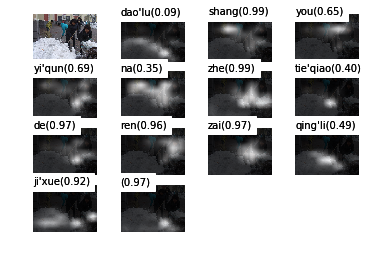

beam search using time(ms): 1488.87896538
一群 手里 拿 着 工具 的 人 在 道路 上 铲 雪 </S> 0.0383256
probs [0.20304804199893023, 0.2499867075652781, 0.993478196207168, 0.9949358965189269, 0.5583211125821037, 0.9688644922228897, 0.9458336393103187, 0.8212143753874522, 0.5146128970077324, 0.9810887441999412, 0.23774166300924035, 0.8150686202809129, 0.9906314881650746, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


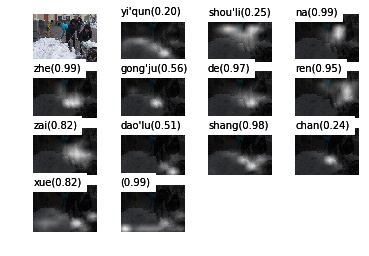

beam search using time(ms): 1480.54885864
道路 上 有 一群 拿 着 工具 的 人 在 铲 雪 </S> 0.0382784
probs [0.08804671336910896, 0.993372078628127, 0.645010013756327, 0.6892700302663615, 0.3461682897950223, 0.9913372995902973, 0.5271262922293343, 0.9604458498525174, 0.9601381534096987, 0.9732815978428558, 0.3610087982211673, 0.9064554550239782, 0.9866400411442258, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


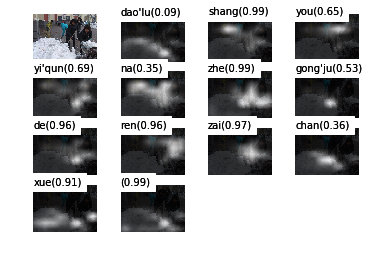

beam search using time(ms): 1410.00413895
白雪皑皑 的 街道 上 有 一群 拿 着 工具 的 人 在 铲 雪 </S> 0.0375665
probs [0.059873445027066104, 0.9887497202395503, 0.3612854509517641, 0.9355477924298826, 0.728148902478777, 0.7975505524058415, 0.5121443281454814, 0.9955955094012627, 0.47802699588131325, 0.9627533937558507, 0.9777340352024877, 0.9841467428145066, 0.6384071413809146, 0.9457601665168941, 0.9894767781002073, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


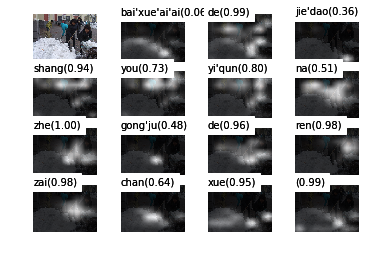

beam search using time(ms): 1628.80086899
白雪皑皑 的 街道 上 有 一群 拿 着 铁锹 的 人 在 铲 雪 </S> 0.0363692
probs [0.059873445027066104, 0.9887497202395503, 0.3612854509517641, 0.9355477924298826, 0.728148902478777, 0.7975505524058415, 0.5121443281454814, 0.9955955094012627, 0.42984023093284246, 0.9726195225107063, 0.979137753751433, 0.9833486400301055, 0.6576253056786217, 0.9479865689901994, 0.9891576696174399, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


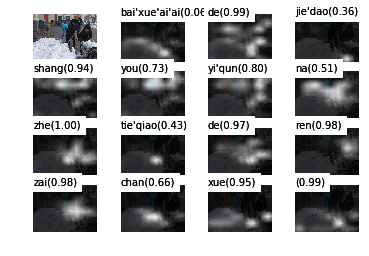

beam search using time(ms): 1850.84104538
房屋 外 的 道路 上 有 一群 拿 着 工具 的 人 在 铲 雪 </S> 0.0331364
probs [0.1694458580627904, 0.3523481940778002, 0.637123340752231, 0.615096544626715, 0.9944607995039588, 0.6263074116785007, 0.7461012411619137, 0.4405361258467069, 0.9941786453036714, 0.487535605202306, 0.9670585274017105, 0.9775540125785674, 0.9791057541218963, 0.5464921415394564, 0.9438889259963911, 0.9905741679201924, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


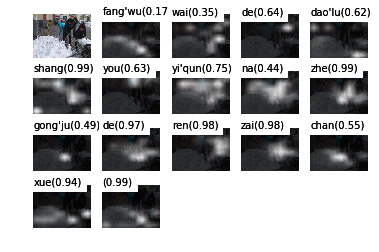

beam search using time(ms): 2306.53500557
房屋 外 的 道路 上 有 一群 拿 着 铁锹 的 人 在 铲 雪 </S> 0.0321549
probs [0.1694458580627904, 0.3523481940778002, 0.637123340752231, 0.615096544626715, 0.9944607995039588, 0.6263074116785007, 0.7461012411619137, 0.4405361258467069, 0.9941786453036714, 0.43318212587000493, 0.9800689363591651, 0.9787798227274493, 0.9784683740936981, 0.5694146630190191, 0.946838230382929, 0.9904720613910454, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


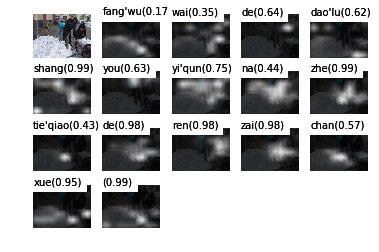

beam search using time(ms): 1481.79411888
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: f08d11c4ee662998f279ce4c4b99e9d506974b48.jpg


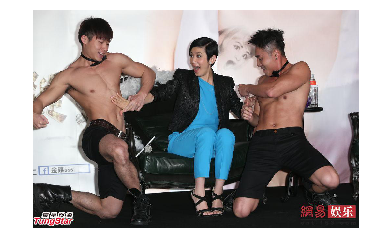

室内 两个 人 的 中间 有 一个 赤裸 上身 的 男人 坐在 沙发 上 </S> 0.00862484
probs [0.22060229131484227, 0.2145749132987617, 0.34745869820205516, 0.6353315222366812, 0.4566041447522767, 0.9309204551001891, 0.9118194887611779, 0.3990129159654334, 0.8094881191137966, 0.9809782591145656, 0.9813469853441747, 0.18712013976300676, 0.4370678299300513, 0.9513638564307495, 0.8839555268028131, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


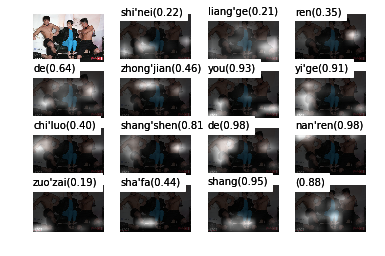

beam search using time(ms): 2966.97092056
室内 两个 人 的 中间 有 一个 赤裸 上身 的 男人 坐在 椅子 上 </S> 0.00747774
probs [0.22060229131484227, 0.2145749132987617, 0.34745869820205516, 0.6353315222366812, 0.4566041447522767, 0.9309204551001891, 0.9118194887611779, 0.3990129159654334, 0.8094881191137966, 0.9809782591145656, 0.9813469853441747, 0.18712013976300676, 0.31488231247907, 0.9770960502910069, 0.9021177449805455, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


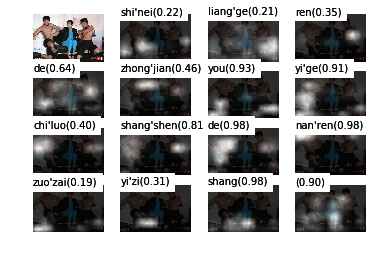

beam search using time(ms): 1761.06190681
室内 两个 人 的 旁边 有 一个 赤裸 上身 的 男人 坐在 沙发 上 </S> 0.00737183
probs [0.22060229131484227, 0.2145749132987617, 0.34745869820205516, 0.6353315222366812, 0.4170007630753018, 0.9588588185005149, 0.8786266489897057, 0.3822419885236079, 0.7850814589036655, 0.9847518910343215, 0.9800031011682219, 0.16647403289971177, 0.42877280043212684, 0.9500675336255037, 0.8820340701972661, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


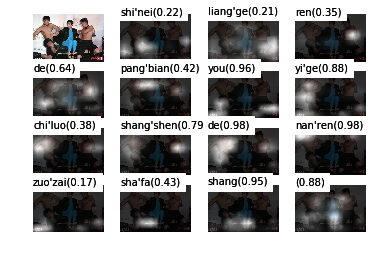

beam search using time(ms): 2054.45313454
室内 两个 人 的 旁边 有 一个 赤裸 上身 的 男人 坐在 椅子 上 </S> 0.00646502
probs [0.22060229131484227, 0.2145749132987617, 0.34745869820205516, 0.6353315222366812, 0.4170007630753018, 0.9588588185005149, 0.8786266489897057, 0.3822419885236079, 0.7850814589036655, 0.9847518910343215, 0.9800031011682219, 0.16647403289971177, 0.3151202360986991, 0.9764041139285785, 0.9019353002745355, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


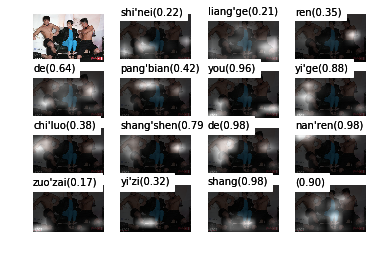

beam search using time(ms): 2486.22584343
房间 里 两个 人 的 中间 有 一个 赤裸 上身 的 男人 坐在 沙发 上 </S> 0.00624131
probs [0.17288162411235938, 0.9933565510345406, 0.19384555497813408, 0.3581787389238472, 0.4738994125896375, 0.4940478873763562, 0.9070133270077697, 0.9207789094037256, 0.2970814510302812, 0.798033943502938, 0.9808346542296286, 0.9837887178780321, 0.1729597502321202, 0.4822056763584967, 0.9583175769726814, 0.9137683312471452, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


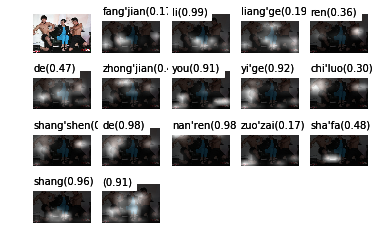

beam search using time(ms): 2621.58608437
房间 里 有 两个 赤裸 上身 的 男人 和 一个 穿着 蓝色 裤子 的 女人 坐在 沙发 上 </S> 0.00578805
probs [0.17288162411235938, 0.9933565510345406, 0.32609820124919503, 0.4518873968164085, 0.2859877961302443, 0.786789500257256, 0.9908885728568524, 0.9762302604061068, 0.5261440397009045, 0.8458899732206747, 0.4943544725521151, 0.2761066068331115, 0.3554048848595604, 0.9965188516319546, 0.84619792531655, 0.42888465179619323, 0.5742786591627017, 0.9830353146228069, 0.8777229420512809, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


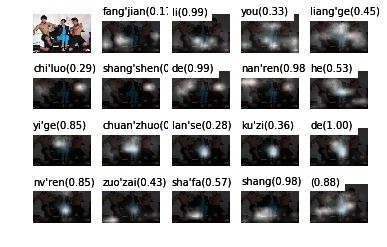

beam search using time(ms): 2983.24298859
屋子里 有 两个 赤裸 上身 的 男人 和 一个 穿着 蓝色 裤子 的 女人 在 交谈 </S> 0.00543828
probs [0.1708676551359353, 0.45913648852027006, 0.40091427053277645, 0.3594003644038339, 0.8056854123465191, 0.990664361780894, 0.9751433203471681, 0.5533194246511272, 0.8271378583153313, 0.5011812064414648, 0.21675806392713576, 0.34003673763768916, 0.9974236278488674, 0.7933724751824668, 0.7123712879791232, 0.30091304793519436, 0.9995653135445046, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


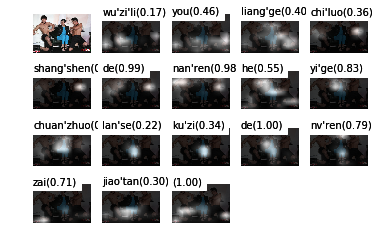

beam search using time(ms): 2576.01094246
房间 里 两个 人 的 中间 有 一个 赤裸 上身 的 男人 坐在 椅子 上 </S> 0.0052316
probs [0.17288162411235938, 0.9933565510345406, 0.19384555497813408, 0.3581787389238472, 0.4738994125896375, 0.4940478873763562, 0.9070133270077697, 0.9207789094037256, 0.2970814510302812, 0.798033943502938, 0.9808346542296286, 0.9837887178780321, 0.1729597502321202, 0.3240149436180734, 0.980945452028688, 0.9334405436238796, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


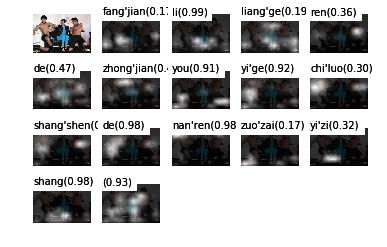

beam search using time(ms): 2818.43113899
房间 里 有 两个 赤裸 上身 的 男人 和 一个 穿着 蓝色 上衣 的 女人 坐在 沙发 上 </S> 0.00493318
probs [0.17288162411235938, 0.9933565510345406, 0.32609820124919503, 0.4518873968164085, 0.2859877961302443, 0.786789500257256, 0.9908885728568524, 0.9762302604061068, 0.5261440397009045, 0.8458899732206747, 0.4943544725521151, 0.2761066068331115, 0.2509367378921591, 0.996721205556833, 0.8188122631552036, 0.467463990633493, 0.55774918136823, 0.9837814485785824, 0.8684795127603278, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


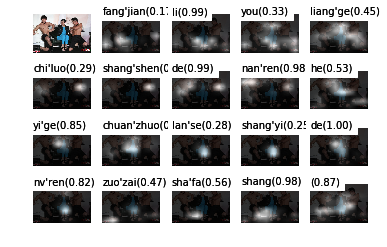

beam search using time(ms): 3393.45598221
房间 里 有 两个 赤裸 上身 的 男人 和 一个 穿着 蓝色 裤子 的 女人 在 交谈 </S> 0.00453554
probs [0.17288162411235938, 0.9933565510345406, 0.32609820124919503, 0.4518873968164085, 0.2859877961302443, 0.786789500257256, 0.9908885728568524, 0.9762302604061068, 0.5261440397009045, 0.8458899732206747, 0.4943544725521151, 0.2761066068331115, 0.3554048848595604, 0.9965188516319546, 0.84619792531655, 0.5081182042286471, 0.2925691899747251, 0.9994901634967481, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


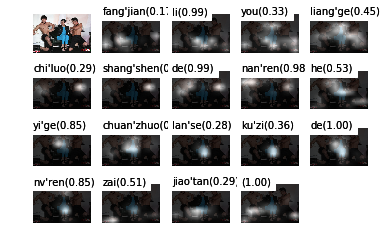

beam search using time(ms): 2279.87599373
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 13bffb7d86bb7a46e356495baa3c6c8179beabd5.jpg


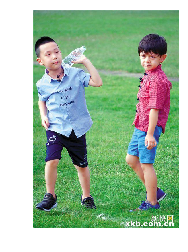

两个 手里 拿 着 瓶子 的 孩子 走 在 草地 上 </S> 0.0265463
probs [0.32951861160626605, 0.12482428919666719, 0.972906268468129, 0.9980057986842944, 0.39619383597927, 0.9824992408647564, 0.31383243293200414, 0.642701881665272, 0.9987876825591229, 0.3997690040131636, 0.96344757762404, 0.9667156087841869, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


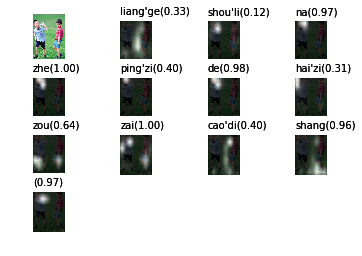

beam search using time(ms): 2729.92110252
两个 手里 拿 着 瓶子 的 小孩 走 在 草地 上 </S> 0.0261232
probs [0.32951861160626605, 0.12482428919666719, 0.972906268468129, 0.9980057986842944, 0.39619383597927, 0.9824992408647564, 0.316864467406757, 0.62735717481125, 0.9987908933597527, 0.3944349869021914, 0.9626806938320914, 0.9656267331220336, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


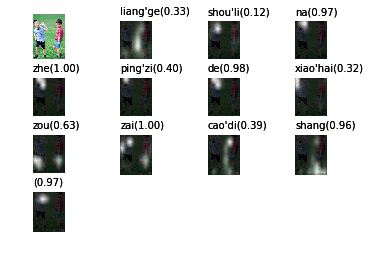

beam search using time(ms): 1379.56500053
绿油油 的 草地 上 走 着 两个 穿着 短裤 的 男孩 </S> 0.0257757
probs [0.07923892539519162, 0.9996071213818376, 0.902884426600371, 0.9757768277575033, 0.2990656139083779, 0.9986328721027733, 0.7221674848587505, 0.34592548051338096, 0.5521562756162848, 0.9876639261038801, 0.39103660090935743, 0.9942542952206087, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


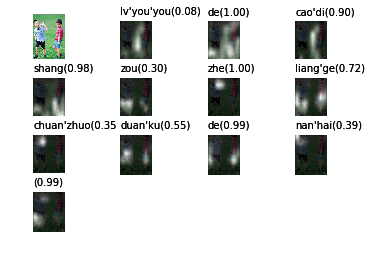

beam search using time(ms): 1310.4929924
两个 手里 拿 着 瓶子 的 男孩 走 在 草地 上 </S> 0.0252013
probs [0.32951861160626605, 0.12482428919666719, 0.972906268468129, 0.9980057986842944, 0.39619383597927, 0.9824992408647564, 0.29365657687738705, 0.6208467849168052, 0.9987925582966121, 0.4003443417652562, 0.964171466661495, 0.9687275433481864, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


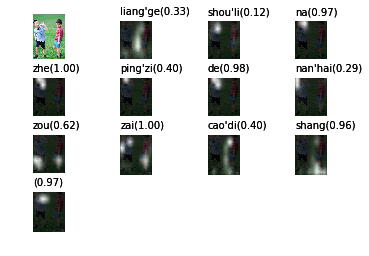

beam search using time(ms): 1419.65794563
两个 右手 拿 着 瓶子 的 孩子 走 在 草地 上 </S> 0.022545
probs [0.32951861160626605, 0.08655351400579724, 0.9416707123080128, 0.9908306379273583, 0.41479557202254325, 0.9809514158751488, 0.34246040114072196, 0.6598377799160843, 0.9986749586521727, 0.37676530817576764, 0.9667754389706398, 0.9666473234159807, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


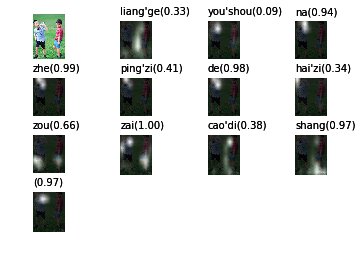

beam search using time(ms): 1371.00100517
一个 左手 拿 着 瓶子 的 男孩 和 一个 穿着 短裤 的 男孩 走 在 草地 上 </S> 0.0219174
probs [0.21259419400830518, 0.2164535777217296, 0.8918527290823218, 0.9555807876105064, 0.5720165738851859, 0.989437680534683, 0.573627090673526, 0.865533426575916, 0.926866190869939, 0.4684172358446223, 0.36108386011412985, 0.998577713213747, 0.5980118443352286, 0.7116695896173519, 0.9993171589489422, 0.5373914233160578, 0.9783283547681444, 0.9911026978404843, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


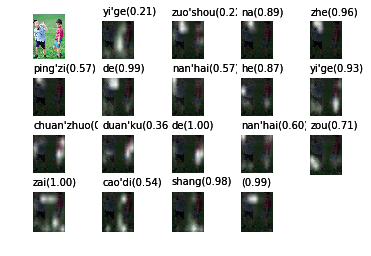

beam search using time(ms): 1574.47504997
绿油油 的 草地 上 走 着 两个 穿着 短裤 的 小孩 </S> 0.0211944
probs [0.07923892539519162, 0.9996071213818376, 0.902884426600371, 0.9757768277575033, 0.2990656139083779, 0.9986328721027733, 0.7221674848587505, 0.34592548051338096, 0.5521562756162848, 0.9876639261038801, 0.2713191886145365, 0.9955226088892214, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


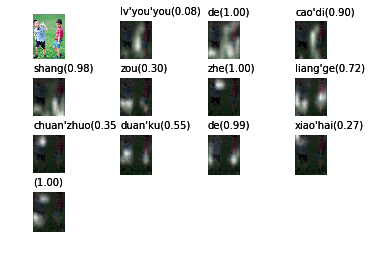

beam search using time(ms): 1144.2258358
一个 右手 拿 着 瓶子 的 男孩 和 一个 穿着 短裤 的 男孩 走 在 草地 上 </S> 0.0203745
probs [0.21259419400830518, 0.2061567227437446, 0.9197305953155412, 0.9534794176635867, 0.5382217637864591, 0.9918603117882437, 0.5650806728864737, 0.8870581289673724, 0.929977484438138, 0.4660321338565419, 0.32880861489298807, 0.9985653508272978, 0.6097605753281123, 0.7069630532954883, 0.9993245399028498, 0.5380900893735179, 0.9777617283293769, 0.9916466797630359, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


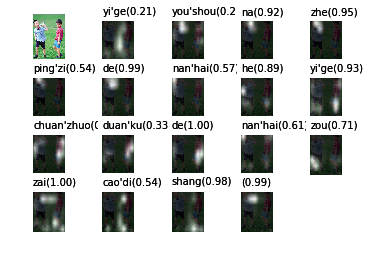

beam search using time(ms): 1710.1650238
绿油油 的 草地 上 走 着 两个 穿着 短裤 的 孩子 </S> 0.0172405
probs [0.07923892539519162, 0.9996071213818376, 0.902884426600371, 0.9757768277575033, 0.2990656139083779, 0.9986328721027733, 0.7221674848587505, 0.34592548051338096, 0.5521562756162848, 0.9876639261038801, 0.18467879237416276, 0.9959047159267292, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


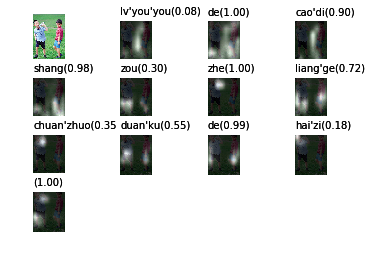

beam search using time(ms): 1238.34300041
一个 左手 拿 着 瓶子 的 男孩 和 一个 穿着 短裤 的 男孩 走 在 绿油油 的 草地 上 </S> 0.0124216
probs [0.21259419400830518, 0.2164535777217296, 0.8918527290823218, 0.9555807876105064, 0.5720165738851859, 0.989437680534683, 0.573627090673526, 0.865533426575916, 0.926866190869939, 0.4684172358446223, 0.36108386011412985, 0.998577713213747, 0.5980118443352286, 0.7116695896173519, 0.9993171589489422, 0.13944609655462448, 0.9998674568439967, 0.923662534347341, 0.9877911601783657, 0.9991405251201729, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


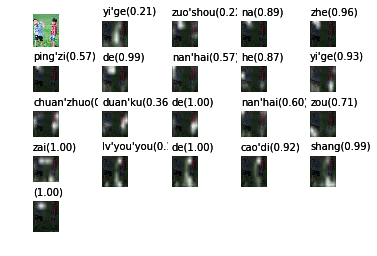

beam search using time(ms): 2350.79407692
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 2e6d6bfe6f7ef5571f62f5b211391bf9e98c0ce0.jpg


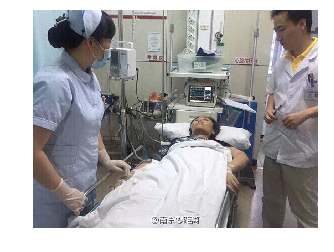

病房 里 有 一个 戴着 口罩 的 女人 看着 一个 躺 在 病床 上 的 人 </S> 0.0173597
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.24200335437591514, 0.9054352807413539, 0.8856558428088922, 0.9071693842347329, 0.4551689248024158, 0.9964045089296594, 0.9938957093889179, 0.4680314030074119, 0.9635189571355811, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


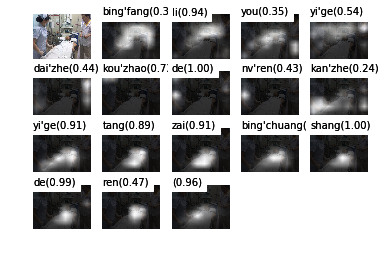

beam search using time(ms): 3454.03313637
病房 里 有 一个 戴着 口罩 的 女人 看着 一个 躺 在 病床 上 的 男人 </S> 0.0169081
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.24200335437591514, 0.9054352807413539, 0.8856558428088922, 0.9071693842347329, 0.4551689248024158, 0.9964045089296594, 0.9938957093889179, 0.4470674311217171, 0.9561317994353987, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


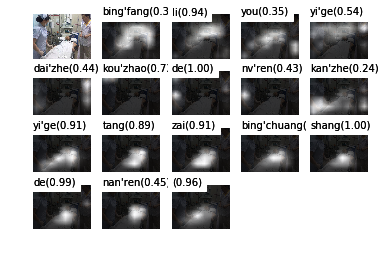

beam search using time(ms): 2103.14106941
病房 里 有 一个 戴着 口罩 的 女人 看着 一个 躺 在 床上 的 人 </S> 0.0167923
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.24200335437591514, 0.9054352807413539, 0.8856558428088922, 0.9071693842347329, 0.4612507643531381, 0.990596276013337, 0.4919152886831003, 0.9577781537878541, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


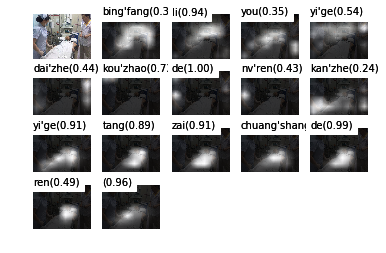

beam search using time(ms): 1909.26980972
病房 里 有 一个 戴着 口罩 的 女人 看着 一个 躺 在 床上 的 男人 </S> 0.0149606
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.24200335437591514, 0.9054352807413539, 0.8856558428088922, 0.9071693842347329, 0.4612507643531381, 0.990596276013337, 0.39999753302979146, 0.9349216651280927, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


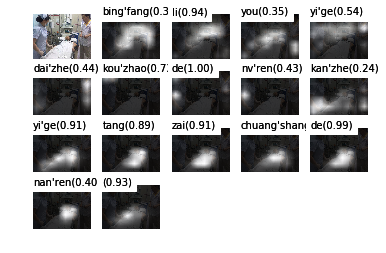

beam search using time(ms): 2052.83617973
病房 里 有 一个 戴着 口罩 的 女人 在 看着 一个 躺 在 病床 上 的 人 </S> 0.0137091
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.5112141558865934, 0.27465253550386887, 0.9416064480001647, 0.7669189734643136, 0.8902106396276511, 0.43991443415330683, 0.9968790961893076, 0.9969994725918795, 0.5039521252851152, 0.982828691817832, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


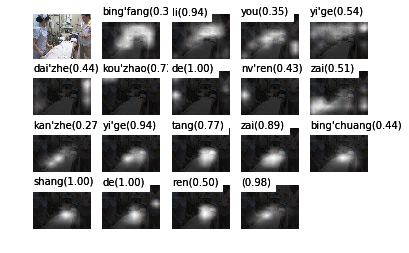

beam search using time(ms): 2135.1788044
病房 里 有 一个 戴着 口罩 的 女人 在 看着 一个 躺 在 床上 的 人 </S> 0.0133974
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.5112141558865934, 0.27465253550386887, 0.9416064480001647, 0.7669189734643136, 0.8902106396276511, 0.4948950237290537, 0.9970992553590866, 0.48241763546910366, 0.9841518223924856, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


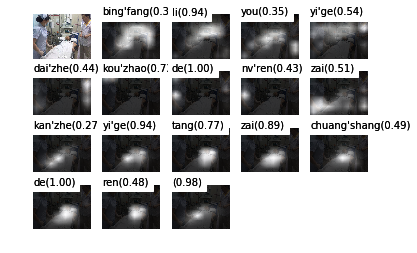

beam search using time(ms): 2262.42303848
病房 里 有 一个 戴着 口罩 的 女人 在 看着 一个 躺 在 病床 上 的 男人 </S> 0.0122091
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.5112141558865934, 0.27465253550386887, 0.9416064480001647, 0.7669189734643136, 0.8902106396276511, 0.43991443415330683, 0.9968790961893076, 0.9969994725918795, 0.39919689626879534, 0.9772949182524957, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


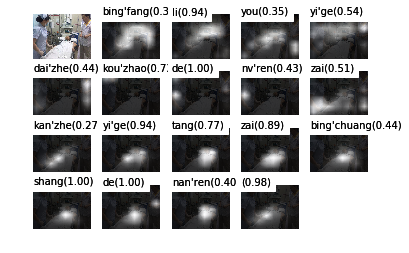

beam search using time(ms): 2314.88704681
病房 里 有 一个 戴着 口罩 的 女人 在 看着 一个 躺 在 床上 的 男人 </S> 0.0121331
probs [0.3019971715405518, 0.9407843397196445, 0.3487853903258739, 0.5411268959447362, 0.44154724586406097, 0.7333995669463416, 0.9964500772075235, 0.4300068475405758, 0.5112141558865934, 0.27465253550386887, 0.9416064480001647, 0.7669189734643136, 0.8902106396276511, 0.4948950237290537, 0.9970992553590866, 0.39795149071728353, 0.975537734249802, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


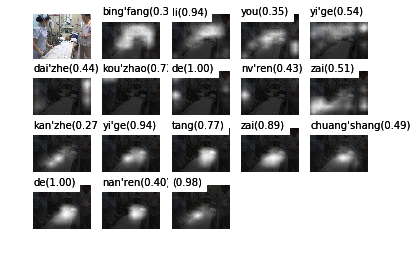

beam search using time(ms): 1875.07891655
病房 里 一个 躺 在 病床 上 的 人 旁边 站 着 两个 戴着 口罩 的 医护人员 </S> 0.0101841
probs [0.3019971715405518, 0.9407843397196445, 0.3640371058521886, 0.20650628999818507, 0.5534752460338217, 0.48262968774880166, 0.9852751507010785, 0.9958191212329566, 0.759291743137838, 0.46279135488913226, 0.6109236551776975, 0.9980870195991175, 0.5088285180391684, 0.4799226266570797, 0.7260372322022239, 0.9869014447912915, 0.43421394479126557, 0.865235778753986, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


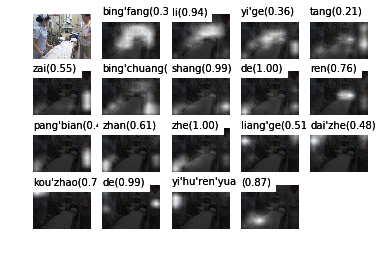

beam search using time(ms): 2633.28409195
病房 里 一个 躺 在 病床 上 的 人 旁站 着 两个 戴着 口罩 的 医护人员 </S> 0.00938687
probs [0.3019971715405518, 0.9407843397196445, 0.3640371058521886, 0.20650628999818507, 0.5534752460338217, 0.48262968774880166, 0.9852751507010785, 0.9958191212329566, 0.759291743137838, 0.2640569672576427, 0.9892299911769595, 0.6226412278390886, 0.43952357496169847, 0.7382151950974253, 0.9913506554842918, 0.3943767565412972, 0.8712627173249411, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


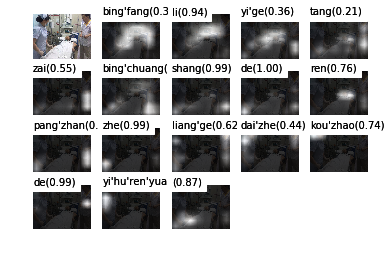

beam search using time(ms): 3067.99793243
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: e921d24cb72a4c30d572f8daa2c6ae54f94eef95.jpg


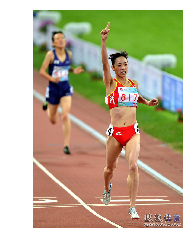

跑道 上 有 两个 穿着 运动服 的 女人 在 奔跑 </S> 0.0689236
probs [0.21382435044767886, 0.9954970907295136, 0.44066008103894705, 0.7973225228112348, 0.7735599527516651, 0.6656018544134071, 0.9855840002159645, 0.5473269525039384, 0.9544414648050789, 0.3884284538878652, 0.9952608705517668, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


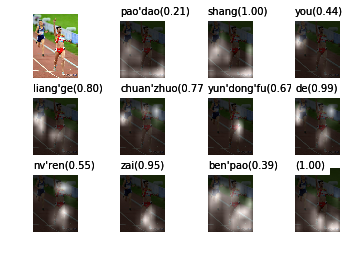

beam search using time(ms): 3019.03390884
跑道 上 有 两个 穿着 运动服 的 女人 在 跑步 </S> 0.0638875
probs [0.21382435044767886, 0.9954970907295136, 0.44066008103894705, 0.7973225228112348, 0.7735599527516651, 0.6656018544134071, 0.9855840002159645, 0.5473269525039384, 0.9544414648050789, 0.3369611530328276, 0.9992110997482678, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


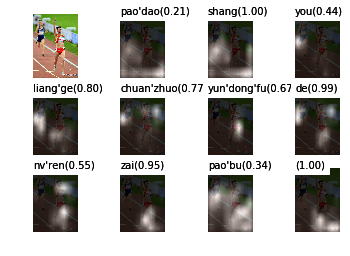

beam search using time(ms): 1497.30205536
两个 穿着 运动服 的 运动员 在 运动场 上 跑步 </S> 0.060245
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.30339235800768033, 0.8054680313941635, 0.5108072897608384, 0.9876678795570804, 0.4180186549095655, 0.9990979232941967, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


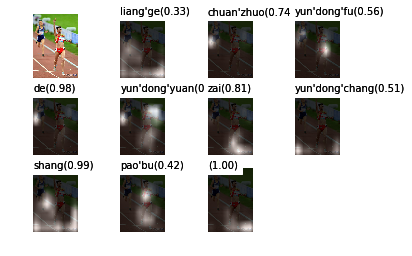

beam search using time(ms): 1358.16311836
两个 穿着 运动服 的 运动员 在 运动场 上 奔跑 </S> 0.0555566
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.30339235800768033, 0.8054680313941635, 0.5108072897608384, 0.9876678795570804, 0.36601540164985186, 0.9879500735445556, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


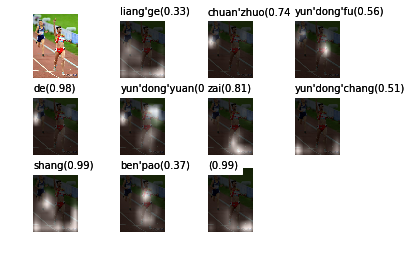

beam search using time(ms): 1326.8558979
两个 穿着 运动服 的 女人 在 运动场 上 奔跑 </S> 0.0545641
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.3591922463586189, 0.5863889386534551, 0.46657085976358986, 0.9798390645525966, 0.4564282017627041, 0.9823737131197916, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


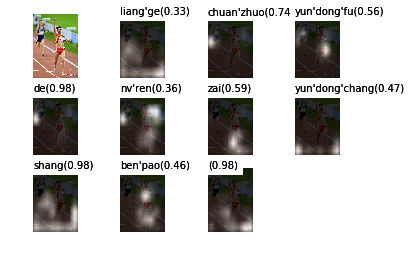

beam search using time(ms): 1236.9351387
两个 穿着 运动服 的 人 在 干净 的 运动场 上 跑步 </S> 0.0514055
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.31520807591574324, 0.7115837815319597, 0.2411608741922113, 0.998344900254042, 0.8634834605211004, 0.9977389553577339, 0.6538675546451207, 0.9979621064050435, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


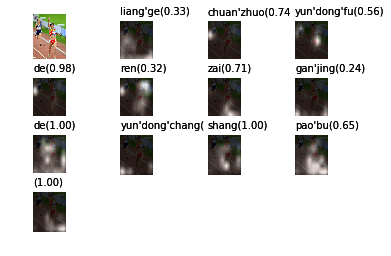

beam search using time(ms): 1434.35692787
运动场 上 有 两个 穿着 运动服 的 女人 在 奔跑 </S> 0.0501831
probs [0.11613139445238702, 0.9849627938200923, 0.4572793758549811, 0.7878574319415195, 0.7996184095653824, 0.6972063173001798, 0.987820356213054, 0.5457237529060055, 0.9478489236645045, 0.368135312340826, 0.995101012922044, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


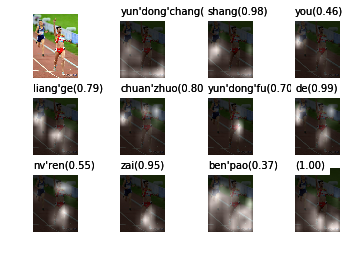

beam search using time(ms): 1312.707901
运动场 上 有 两个 穿着 运动服 的 女人 在 跑步 </S> 0.049311
probs [0.11613139445238702, 0.9849627938200923, 0.4572793758549811, 0.7878574319415195, 0.7996184095653824, 0.6972063173001798, 0.987820356213054, 0.5457237529060055, 0.9478489236645045, 0.3551343015492828, 0.9991173197962371, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


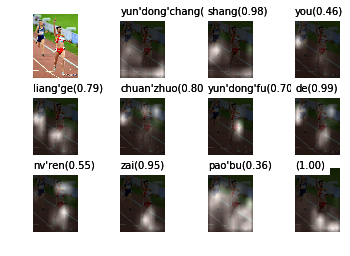

beam search using time(ms): 1361.26112938
两个 穿着 运动服 的 运动员 在 跑道 上 跑步 </S> 0.0480769
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.30339235800768033, 0.8054680313941635, 0.3771970883897358, 0.9942269562888306, 0.3766030691067204, 0.9988290685399853, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


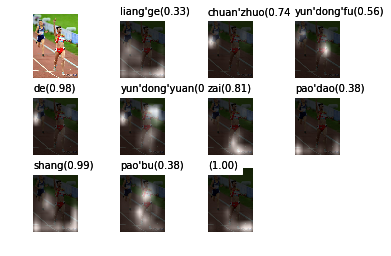

beam search using time(ms): 1395.24483681
两个 穿着 运动服 的 运动员 在 跑道 上 奔跑 </S> 0.0468434
probs [0.3294645644480118, 0.7354775880432914, 0.5551377794846766, 0.9769093214777113, 0.30339235800768033, 0.8054680313941635, 0.3771970883897358, 0.9942269562888306, 0.37024214408760203, 0.9700963008819801, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


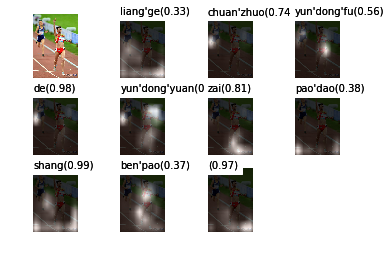

beam search using time(ms): 1209.2051506
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: ed2a8d7c31ddd4b483fffde44dc53911332948b6.jpg


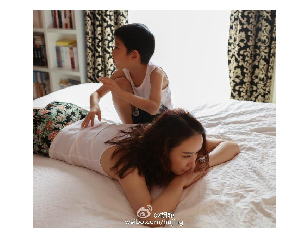

房间 里 有 一个 穿着 白色 上衣 的 女人 和 一个 穿着 白色 上衣 的 女人 躺 在 床上 </S> 0.00606795
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.2663272988676684, 0.3626187674542055, 0.9880009223507682, 0.42120933557294077, 0.5314143537090561, 0.5162238299971805, 0.9974309809993255, 0.73538564383679, 0.31983671706570965, 0.997802804352422, 0.9771959870399476, 0.8613928585800068, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


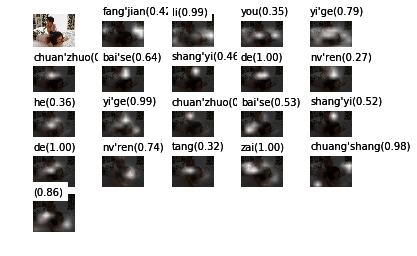

beam search using time(ms): 3550.56619644
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 白色 上衣 的 女人 躺 在 床上 </S> 0.00580683
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.3734720101169209, 0.49025419417134386, 0.9973089588790759, 0.9548954983589487, 0.29391976928941327, 0.9977747951969742, 0.9751384452867561, 0.8579123705987813, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


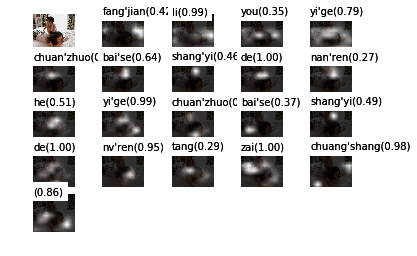

beam search using time(ms): 2137.18891144
房间 里 的 床上 有 一个 穿着 白色 上衣 的 男人 看着 一个 趴在 床上 的 女人 </S> 0.0057321
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.26174619833058427, 0.2113779182100784, 0.976956081767881, 0.25734336600125846, 0.8818929483904271, 0.9707245007599159, 0.9732972938692818, 0.9627602440637477, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


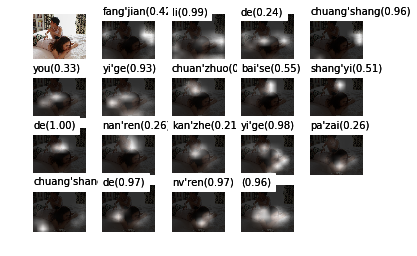

beam search using time(ms): 2919.80600357
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 裙子 的 女人 躺 在 床上 </S> 0.00549534
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.13305688941221608, 0.9970915515486527, 0.9665726983044041, 0.3919932875650899, 0.9981322667287058, 0.9678944910847315, 0.9019714744458306, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


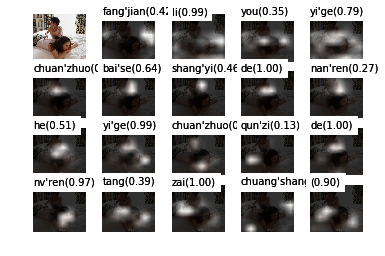

beam search using time(ms): 2072.63493538
房间 里 的 床上 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00470667
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.5059215829096042, 0.2659970951403101, 0.621773405141592, 0.4901765005536478, 0.997069981938965, 0.2991247654288737, 0.26036452583974373, 0.4129185527596392, 0.9860898295177228, 0.30978233564292434, 0.9742371960615699, 0.9637919472085278, 0.9224714951906299, 0.43190796969601297, 0.9353406209977234, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


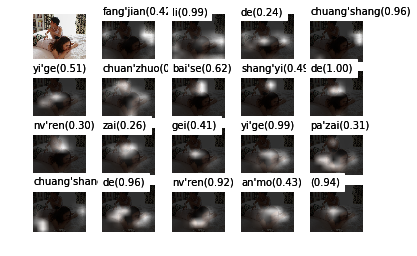

beam search using time(ms): 1865.22698402
房间 里 的 床上 有 一个 穿着 白色 上衣 的 男人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00464509
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.26174619833058427, 0.3005274599320171, 0.2979725834708573, 0.9861192728263485, 0.54469454080298, 0.9649106480123409, 0.9620368196342541, 0.9832882420681801, 0.4980894256981603, 0.9409370376429513, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


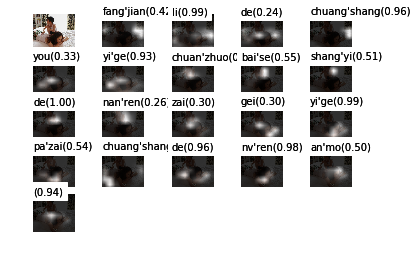

beam search using time(ms): 1899.5051384
房间 里 的 床上 有 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00415576
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.2192440512537927, 0.40240985836903503, 0.35494485925752456, 0.9863511728207462, 0.33552429074180434, 0.964285513646878, 0.9595316994056772, 0.9459613115552171, 0.5017764152286588, 0.9350899718104501, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


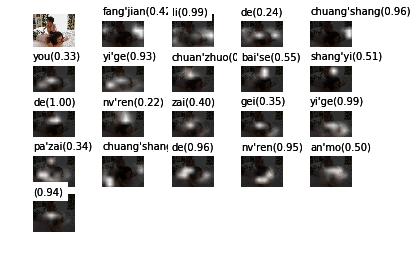

beam search using time(ms): 2118.77584457
房间 里 的 床上 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 做 按摩 </S> 0.00297337
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.5059215829096042, 0.2659970951403101, 0.621773405141592, 0.4901765005536478, 0.997069981938965, 0.2991247654288737, 0.26036452583974373, 0.4129185527596392, 0.9860898295177228, 0.30978233564292434, 0.9742371960615699, 0.9637919472085278, 0.9224714951906299, 0.21667570301383662, 0.6127305207921184, 0.9971422795324923, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


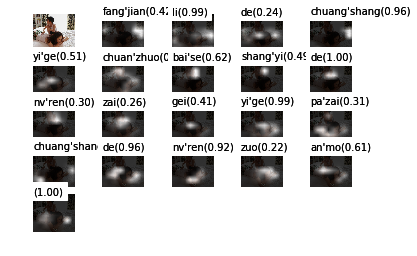

beam search using time(ms): 2334.23399925
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 白色 上衣 的 女人 在 床上 </S> 0.00266241
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.3734720101169209, 0.49025419417134386, 0.9973089588790759, 0.9548954983589487, 0.3535200108549834, 0.35514467385115706, 0.4406964338347832, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


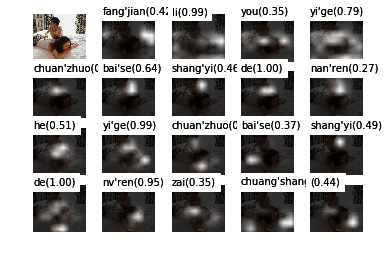

beam search using time(ms): 2239.33410645
房间 里 有 一个 穿着 白色 上衣 的 女人 和 一个 穿着 白色 上衣 的 女人 在 床上 </S> 0.00248272
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.2663272988676684, 0.3626187674542055, 0.9880009223507682, 0.42120933557294077, 0.5314143537090561, 0.5162238299971805, 0.9974309809993255, 0.73538564383679, 0.34851469492402104, 0.33807486462926994, 0.40490468828610804, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


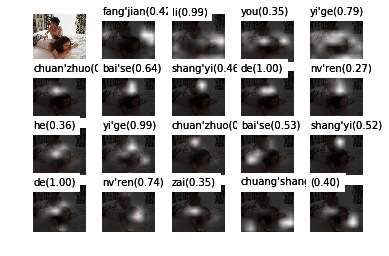

beam search using time(ms): 1984.10105705
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: ed2a8d7c31ddd4b483fffde44dc53911332948b6.jpg


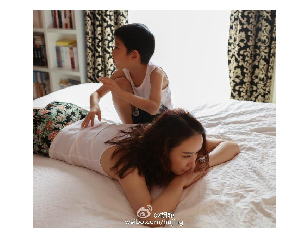

房间 里 有 一个 穿着 白色 上衣 的 女人 和 一个 穿着 白色 上衣 的 女人 躺 在 床上 </S> 0.00606795
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.2663272988676684, 0.3626187674542055, 0.9880009223507682, 0.42120933557294077, 0.5314143537090561, 0.5162238299971805, 0.9974309809993255, 0.73538564383679, 0.31983671706570965, 0.997802804352422, 0.9771959870399476, 0.8613928585800068, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


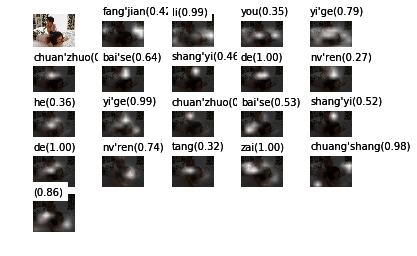

beam search using time(ms): 3868.75295639
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 白色 上衣 的 女人 躺 在 床上 </S> 0.00580683
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.3734720101169209, 0.49025419417134386, 0.9973089588790759, 0.9548954983589487, 0.29391976928941327, 0.9977747951969742, 0.9751384452867561, 0.8579123705987813, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


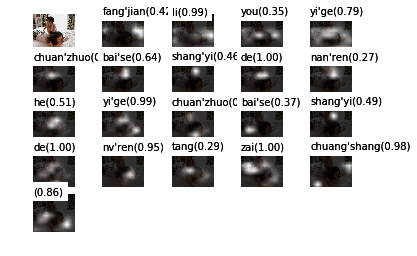

beam search using time(ms): 2099.20501709
房间 里 的 床上 有 一个 穿着 白色 上衣 的 男人 看着 一个 趴在 床上 的 女人 </S> 0.0057321
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.26174619833058427, 0.2113779182100784, 0.976956081767881, 0.25734336600125846, 0.8818929483904271, 0.9707245007599159, 0.9732972938692818, 0.9627602440637477, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


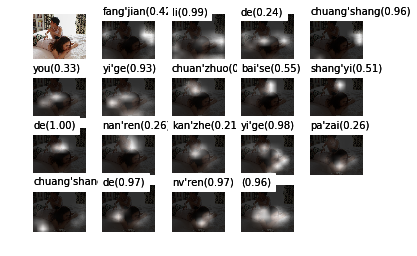

beam search using time(ms): 1874.10116196
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 裙子 的 女人 躺 在 床上 </S> 0.00549534
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.13305688941221608, 0.9970915515486527, 0.9665726983044041, 0.3919932875650899, 0.9981322667287058, 0.9678944910847315, 0.9019714744458306, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


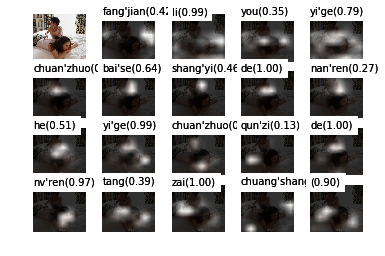

beam search using time(ms): 2032.79495239
房间 里 的 床上 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00470667
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.5059215829096042, 0.2659970951403101, 0.621773405141592, 0.4901765005536478, 0.997069981938965, 0.2991247654288737, 0.26036452583974373, 0.4129185527596392, 0.9860898295177228, 0.30978233564292434, 0.9742371960615699, 0.9637919472085278, 0.9224714951906299, 0.43190796969601297, 0.9353406209977234, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


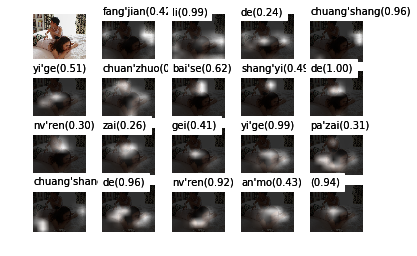

beam search using time(ms): 1888.18287849
房间 里 的 床上 有 一个 穿着 白色 上衣 的 男人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00464509
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.26174619833058427, 0.3005274599320171, 0.2979725834708573, 0.9861192728263485, 0.54469454080298, 0.9649106480123409, 0.9620368196342541, 0.9832882420681801, 0.4980894256981603, 0.9409370376429513, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


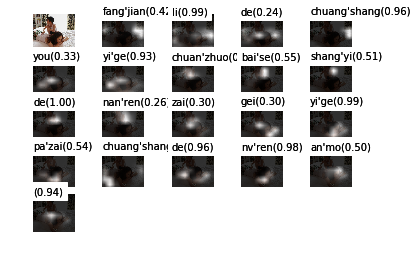

beam search using time(ms): 2220.90816498
房间 里 的 床上 有 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 按摩 </S> 0.00415576
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.33039426175970504, 0.9260824916287528, 0.25740350135717405, 0.5478729460223142, 0.5101691041376488, 0.9980673067859949, 0.2192440512537927, 0.40240985836903503, 0.35494485925752456, 0.9863511728207462, 0.33552429074180434, 0.964285513646878, 0.9595316994056772, 0.9459613115552171, 0.5017764152286588, 0.9350899718104501, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


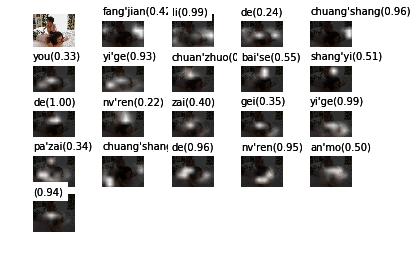

beam search using time(ms): 1925.21500587
房间 里 的 床上 一个 穿着 白色 上衣 的 女人 在 给 一个 趴在 床上 的 女人 做 按摩 </S> 0.00297337
probs [0.42365611863416575, 0.9901751013255362, 0.2438795756252825, 0.9622600702385724, 0.5059215829096042, 0.2659970951403101, 0.621773405141592, 0.4901765005536478, 0.997069981938965, 0.2991247654288737, 0.26036452583974373, 0.4129185527596392, 0.9860898295177228, 0.30978233564292434, 0.9742371960615699, 0.9637919472085278, 0.9224714951906299, 0.21667570301383662, 0.6127305207921184, 0.9971422795324923, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


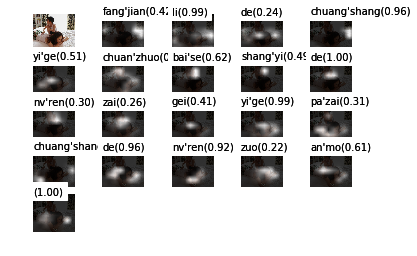

beam search using time(ms): 2417.50097275
房间 里 有 一个 穿着 白色 上衣 的 男人 和 一个 穿着 白色 上衣 的 女人 在 床上 </S> 0.00266241
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.266017358170571, 0.5146845855469049, 0.9872635981247182, 0.34231672918326655, 0.3734720101169209, 0.49025419417134386, 0.9973089588790759, 0.9548954983589487, 0.3535200108549834, 0.35514467385115706, 0.4406964338347832, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


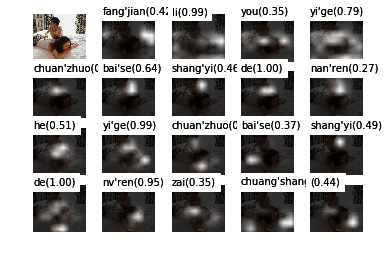

beam search using time(ms): 2142.13585854
房间 里 有 一个 穿着 白色 上衣 的 女人 和 一个 穿着 白色 上衣 的 女人 在 床上 </S> 0.00248272
probs [0.42365611863416575, 0.9901751013255362, 0.35298431769581085, 0.7869160718500509, 0.2768376488241503, 0.6384559259483756, 0.459932014396919, 0.9960919168004736, 0.2663272988676684, 0.3626187674542055, 0.9880009223507682, 0.42120933557294077, 0.5314143537090561, 0.5162238299971805, 0.9974309809993255, 0.73538564383679, 0.34851469492402104, 0.33807486462926994, 0.40490468828610804, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


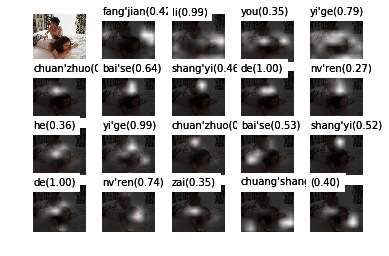

beam search using time(ms): 2761.51895523
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: d867576e890a287df9888d6f066734a9e8ffba60.jpg


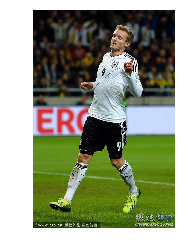

一个 穿着 运动服 的 男人 在 运动场 上 奔跑 </S> 0.0871561
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.3865289887954018, 0.4905181054448085, 0.9918277097774707, 0.6732149229343507, 0.996038575998796, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


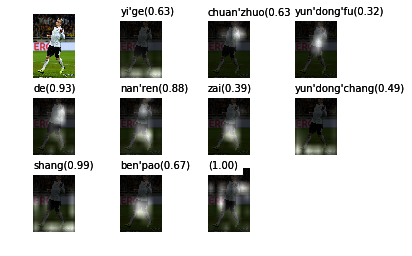

beam search using time(ms): 2269.23418045
碧绿 的 球场上 跑 着 一位 穿着 球服 的 男士 </S> 0.0743585
probs [0.03372271653198937, 0.9996743071173864, 0.94673799837554, 0.7395650821045541, 0.9998071565635409, 0.8900495022682499, 0.5261095441403236, 0.801258697683656, 0.997039880865136, 0.99897882422004, 0.9978762763366926, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


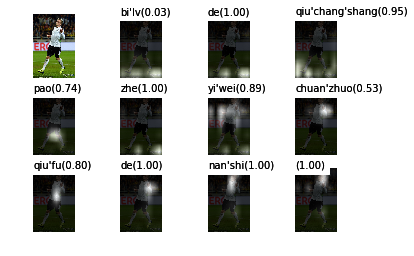

beam search using time(ms): 1307.91783333
一个 穿着 运动服 的 男人 奔跑 在 运动场 上 </S> 0.0639365
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.22357656809314133, 0.9959749521328035, 0.33420588666350887, 0.9988865151611339, 0.9777608177182308, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


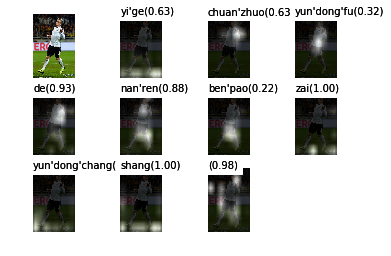

beam search using time(ms): 1203.35507393
运动场 上 跑 着 一个 穿着 运动服 的 男人 </S> 0.0549646
probs [0.04679551800673975, 0.9967281928938487, 0.5291943268021958, 0.9984986705837912, 0.9688441251486396, 0.7264213794781726, 0.7286152007703582, 0.6280847297530905, 0.7269957824059377, 0.9960492197191284, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


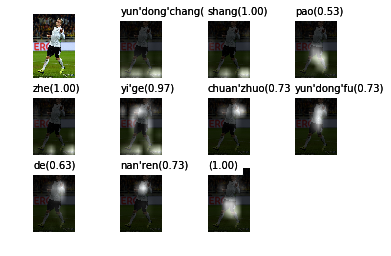

beam search using time(ms): 1224.04909134
足球场 上 跑 着 一个 穿着 运动服 的 男人 </S> 0.0530861
probs [0.08815493046005757, 0.997454819717811, 0.29091343554242527, 0.9986428584412104, 0.9701511630955229, 0.6191999220257882, 0.6076568459585748, 0.6708554021066582, 0.8686565037979367, 0.9943536472002429, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


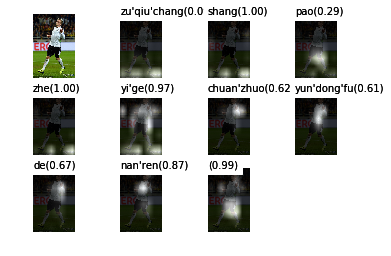

beam search using time(ms): 1280.83896637
一个 穿着 运动服 的 男人 在 运动场 上 跑步 </S> 0.0518908
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.3865289887954018, 0.4905181054448085, 0.9918277097774707, 0.2668589208082282, 0.9992320479075765, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


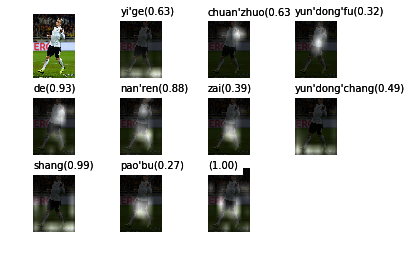

beam search using time(ms): 1214.65587616
一个 穿着 运动服 的 男人 跑 在 运动场 上 </S> 0.0509267
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.22910390489748908, 0.9830802440242477, 0.24475241391497307, 0.9985797339851238, 0.8810629187022352, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


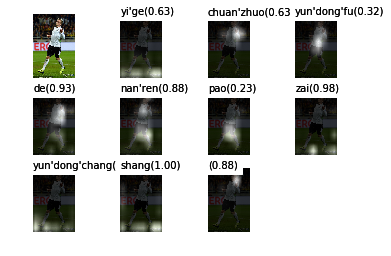

beam search using time(ms): 1439.37897682
一个 穿着 运动服 的 男人 在 足球场 上 奔跑 </S> 0.049511
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.3865289887954018, 0.16635994197339102, 0.9957918143929536, 0.7271395299387624, 0.9907131506326999, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


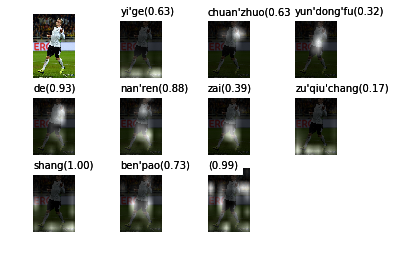

beam search using time(ms): 1190.89317322
一个 穿着 运动服 的 男人 跑 在 宽敞 的 球场上 </S> 0.0478143
probs [0.6320239045983095, 0.6319340454797039, 0.3150359884855479, 0.9328602800091429, 0.8815931165260878, 0.22910390489748908, 0.9830802440242477, 0.31671624232338663, 0.9996416661154023, 0.5351713071165173, 0.9972034441901966, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


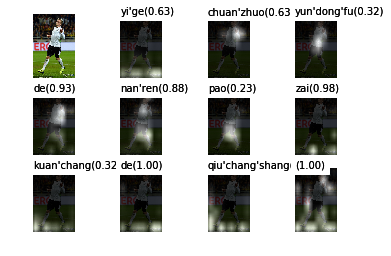

beam search using time(ms): 1376.32894516
一个 穿着 短袖 上衣 的 男人 在 运动场 上 奔跑 </S> 0.0427696
probs [0.6320239045983095, 0.6319340454797039, 0.05351514174863961, 0.90746251944022, 0.9590824570671871, 0.86719276346547, 0.6917449693914496, 0.6472405727854413, 0.99502653293203, 0.44836404655029644, 0.997511396600866, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


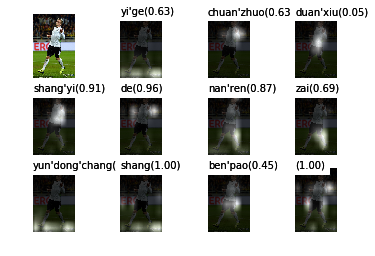

beam search using time(ms): 1591.02892876
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 2e467612c3d736046c6e60898ed70ea3a5b2e15f.jpg


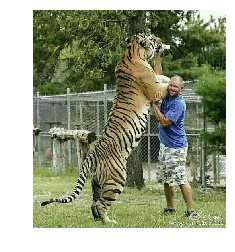

草地 上 有 一个 穿着 短袖 的 男人 在 摸 一只 老虎 </S> 0.037107
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.31135628029863444, 0.7352056900236337, 0.9324568021266684, 0.7973529982392722, 0.32928779477120595, 0.5385585541415497, 0.8781174830055731, 0.9398564600263255, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


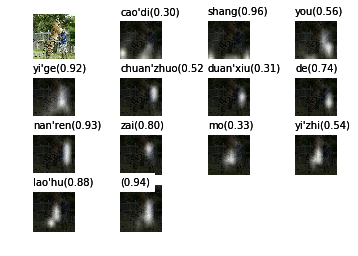

beam search using time(ms): 1932.42406845
草地 上 有 一个 穿着 蓝色 上衣 的 男人 在 摸 一只 老虎 </S> 0.0346733
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.5038248407952589, 0.4461544157491289, 0.9943709735455799, 0.9342504814545564, 0.6553419857547251, 0.32814372228645977, 0.5370336278070337, 0.8661998880750911, 0.9303781981348519, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


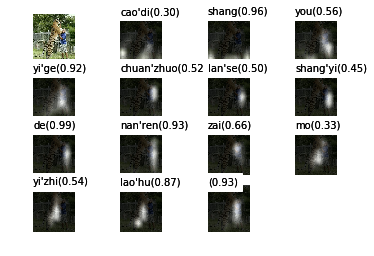

beam search using time(ms): 1209.90896225
草地 上 有 一个 穿着 蓝色 短袖 的 男人 在 摸 一只 老虎 </S> 0.0254257
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.5038248407952589, 0.2411668252292472, 0.9315424729969561, 0.9498012969427769, 0.7458173916711196, 0.32410483783662397, 0.5144924263142769, 0.8638971405500065, 0.9234175946067242, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


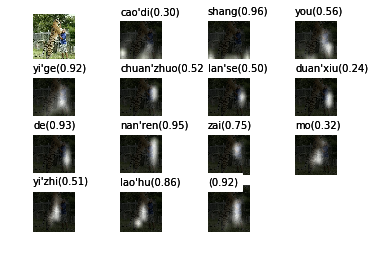

beam search using time(ms): 1093.50895882
草地 上 有 一个 穿着 短袖 的 男人 在 给 一只 老虎 喂食 </S> 0.0215972
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.31135628029863444, 0.7352056900236337, 0.9324568021266684, 0.7973529982392722, 0.3072878758439429, 0.4933465916051679, 0.8891575970526245, 0.33959664459528144, 0.9984035983657774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


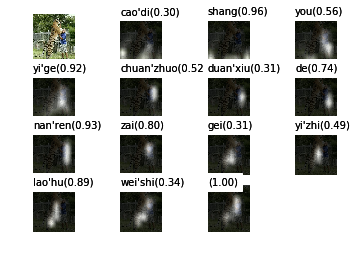

beam search using time(ms): 1852.53500938
绿油油 的 草地 上 有 一个 穿着 短袖 的 男人 在 摸 一只 老虎 </S> 0.021281
probs [0.09396482344107228, 0.997949878039997, 0.9010966653705518, 0.9698545996793423, 0.5718167448180145, 0.9252845020293399, 0.41550656798151336, 0.2931872338961642, 0.7843355230911225, 0.9165479559501125, 0.7958604545619454, 0.4088559071022345, 0.4999933829758882, 0.8696184250175335, 0.9535436894937727, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


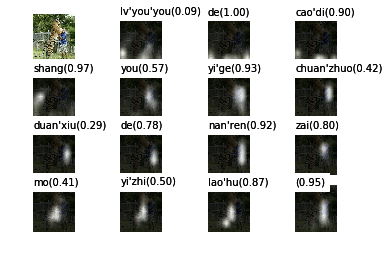

beam search using time(ms): 1343.80817413
草地 上 有 一个 穿着 蓝色 上衣 的 男人 在 抚摸 一只 老虎 </S> 0.0210126
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.5038248407952589, 0.4461544157491289, 0.9943709735455799, 0.9342504814545564, 0.6553419857547251, 0.1046359650869754, 0.6148445774602034, 0.8707795786090089, 0.9621468327041076, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


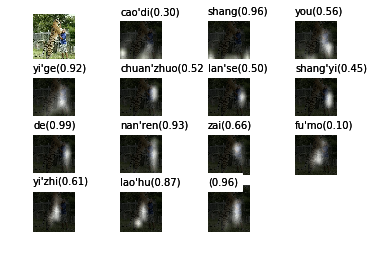

beam search using time(ms): 1200.75798035
绿油油 的 草地 上 有 一个 穿着 蓝色 上衣 的 男人 在 摸 一只 老虎 </S> 0.0199881
probs [0.09396482344107228, 0.997949878039997, 0.9010966653705518, 0.9698545996793423, 0.5718167448180145, 0.9252845020293399, 0.41550656798151336, 0.5102958318786078, 0.4424014672094747, 0.9949154822025293, 0.9195773444674641, 0.6957575983732597, 0.3808760640076446, 0.5022579289502396, 0.8565801868328786, 0.941736998239846, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


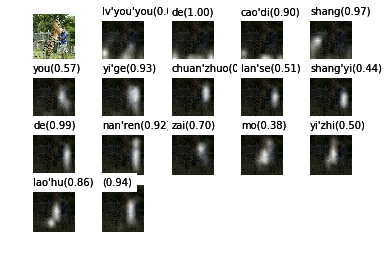

beam search using time(ms): 1324.51200485
草地 上 有 一个 穿着 蓝色 上衣 的 男人 在 给 一只 老虎 喂食 </S> 0.0170392
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.5038248407952589, 0.4461544157491289, 0.9943709735455799, 0.9342504814545564, 0.6553419857547251, 0.25310690531358443, 0.48199754516959564, 0.8770261686046518, 0.29331962185761246, 0.9983742485298467, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


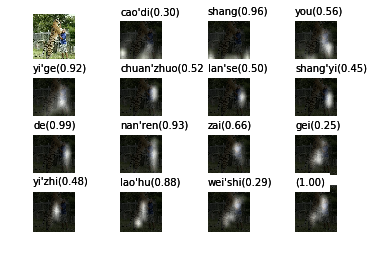

beam search using time(ms): 1506.12092018
绿茵茵 的 草地 上 有 一个 穿着 蓝色 上衣 的 男人 在 摸 一只 老虎 </S> 0.0158663
probs [0.04683945225851526, 0.9999029730532689, 0.9285983114212089, 0.9538424004180787, 0.7138101804019763, 0.9294384843638416, 0.4355090508171401, 0.4708577069891278, 0.4261046444204564, 0.9957681733062094, 0.930934299255298, 0.6946432079976663, 0.3976919152294349, 0.4960143223678237, 0.8656514979142582, 0.9520243136405894, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


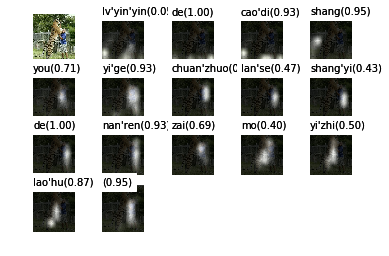

beam search using time(ms): 1529.41298485
草地 上 有 一个 穿着 蓝色 短袖 的 男人 在 给 一只 老虎 喂食 </S> 0.0142381
probs [0.3013175210629849, 0.9638701278531878, 0.5550651543412597, 0.9248438037194991, 0.5173882222016274, 0.5038248407952589, 0.2411668252292472, 0.9315424729969561, 0.9498012969427769, 0.7458173916711196, 0.2746594767119086, 0.48001766392771217, 0.8786878588272073, 0.32477041252238886, 0.9981854759737007, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


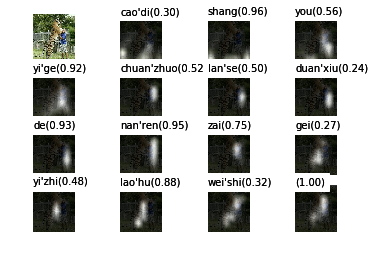

beam search using time(ms): 1428.30991745
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: e531bfa5b96493a1982aae21eb7ddad492d79678.jpg


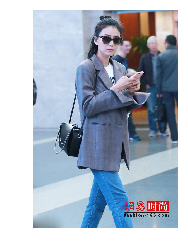

一个 戴着 墨镜 的 女人 走 在 人来人往 的 大厅 里 </S> 0.109711
probs [0.43694017128920426, 0.3776428012241769, 0.9491086966649293, 0.8579522061264704, 0.8576862405986152, 0.3671253013190782, 0.9942988419280269, 0.43523397908265493, 0.9996664444870847, 0.9669130592105352, 0.9673317419512243, 0.9554847877596916, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


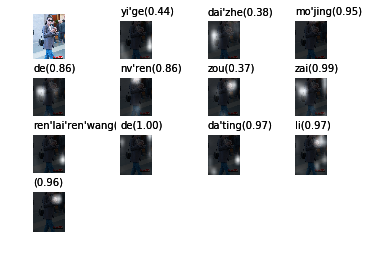

beam search using time(ms): 2124.70316887
人来人往 的 大厅 里 走 着 一个 戴着 墨镜 的 女人 </S> 0.0853821
probs [0.06378140513156388, 0.9997393572502513, 0.963015006114994, 0.9726977905368902, 0.6975907815056873, 0.9998224097038693, 0.9028131970675365, 0.3491419830361227, 0.9644641185694921, 0.9158082978917914, 0.9274628066426406, 0.9535581080924026, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


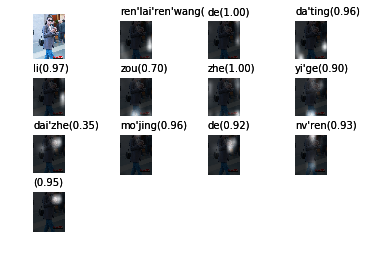

beam search using time(ms): 1104.83789444
一个 双手 拿 着 手机 的 女人 走 在 人来人往 的 大厅 里 </S> 0.0754765
probs [0.43694017128920426, 0.07555284487200498, 0.8818756021387708, 0.9922247062083681, 0.7240390718508845, 0.9721382295733584, 0.8901806940050035, 0.9169531102564572, 0.9990782896677067, 0.4285215990917231, 0.999475277781232, 0.9709887783114979, 0.9884263051819174, 0.9903812006435057, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


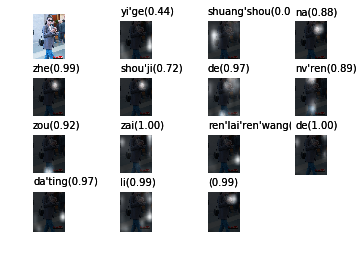

beam search using time(ms): 1465.86894989
一个 右肩 背着 包 的 女人 走 在 人来人往 的 大厅 里 </S> 0.0680082
probs [0.43694017128920426, 0.09369637213058436, 0.8190935381477525, 0.9708522398517753, 0.986063980560344, 0.9035852428720912, 0.6596450153770657, 0.9982751607362425, 0.3422114216552848, 0.9997465061067621, 0.9735476069941877, 0.9900936436530083, 0.963719197582062, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


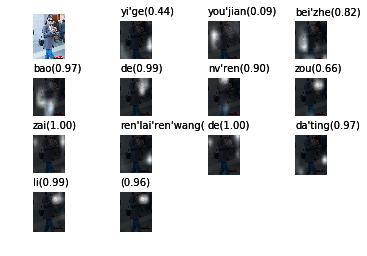

beam search using time(ms): 1381.71601295
人来人往 的 大厅 里 走 着 一个 双手 拿 着 手机 的 女人 </S> 0.0670505
probs [0.06378140513156388, 0.9997393572502513, 0.963015006114994, 0.9726977905368902, 0.6975907815056873, 0.9998224097038693, 0.9028131970675365, 0.26373778409314197, 0.8751133259594385, 0.9765673426611314, 0.7016113084098121, 0.9767530291193948, 0.927145851396729, 0.9967486817684662, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


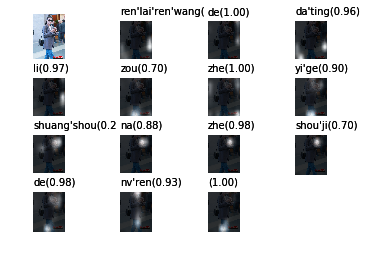

beam search using time(ms): 1368.06106567
大厅 里 一个 人 的 前面 走 着 一个 戴着 墨镜 的 女人 </S> 0.0550627
probs [0.30812788482798764, 0.966897123952992, 0.33727067597049376, 0.3844997896959827, 0.6504413371468603, 0.5779243470089118, 0.9572126819089266, 0.9996204625164449, 0.9942253067173846, 0.31791387847482844, 0.9759194103637803, 0.9659122630787002, 0.935919693972876, 0.9464587781579324, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


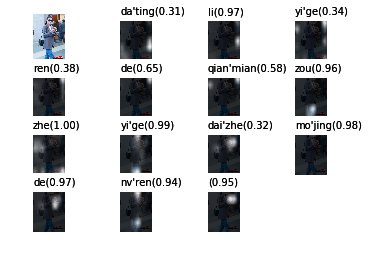

beam search using time(ms): 1848.48499298
一个 双手 拿 着 手机 的 女人 走 在 大厅 里 </S> 0.052525
probs [0.43694017128920426, 0.07555284487200498, 0.8818756021387708, 0.9922247062083681, 0.7240390718508845, 0.9721382295733584, 0.8901806940050035, 0.9169531102564572, 0.9990782896677067, 0.2923403471198921, 0.9826696952879238, 0.8718301996280854, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


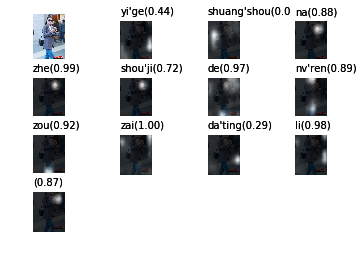

beam search using time(ms): 1303.26700211
一个 右肩 背着 包 的 女人 走 在 大厅 里 </S> 0.040155
probs [0.43694017128920426, 0.09369637213058436, 0.8190935381477525, 0.9708522398517753, 0.986063980560344, 0.9035852428720912, 0.6596450153770657, 0.9982751607362425, 0.299403244844711, 0.9792117037786112, 0.5116659927281962, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


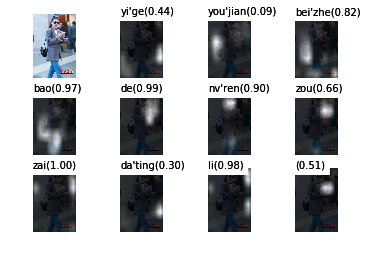

beam search using time(ms): 1000.81992149
一个 戴着 墨镜 的 女人 拿 着 手机 行走 在 人来人往 的 大厅 里 </S> 0.0311676
probs [0.43694017128920426, 0.3776428012241769, 0.9491086966649293, 0.8579522061264704, 0.8576862405986152, 0.14442272759148544, 0.9993748998338264, 0.8987375727077712, 0.6162849732281293, 0.9997287532382807, 0.1868681796443133, 0.9998773486866799, 0.837572526728707, 0.7590057933959774, 0.9922087456050774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


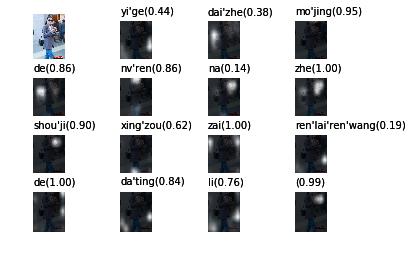

beam search using time(ms): 1423.20013046
一个 戴着 墨镜 的 女人 拿 着 手机 行走 在 人群 熙攘 的 大厅 内 </S> 0.0308444
probs [0.43694017128920426, 0.3776428012241769, 0.9491086966649293, 0.8579522061264704, 0.8576862405986152, 0.14442272759148544, 0.9993748998338264, 0.8987375727077712, 0.6162849732281293, 0.9997287532382807, 0.26357714322697207, 0.8428511095893669, 0.9999073829640566, 0.9472944733058196, 0.4969399113787667, 0.9878139577770675, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


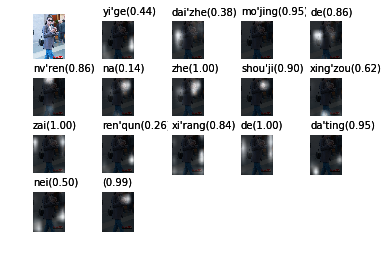

beam search using time(ms): 1437.36696243
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: eface8dff3eb8b807cea2eb33fc9b1c2e94a9bd0.jpg


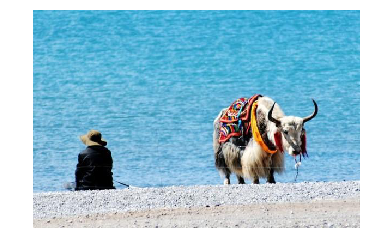

海边 的 道路 上 走 着 一个 牵着 狗 的 男人 </S> 0.0302404
probs [0.2535304010789143, 0.6737306486180661, 0.34251421200769017, 0.9988157485196595, 0.1777297712712214, 0.9947137429182547, 0.8628364333400542, 0.5029301026198912, 0.5572453900494886, 0.9698627849425715, 0.6264428065690709, 0.9791315820784252, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


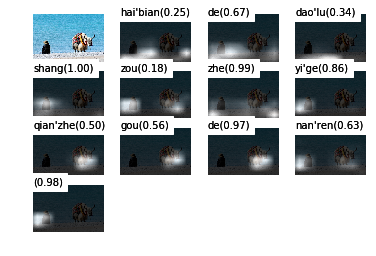

beam search using time(ms): 1974.55406189
一个 牵着 狗 的 男人 走 在 海边 的 沙滩 上 </S> 0.0296058
probs [0.3066738124799828, 0.20407105384537208, 0.6874293955376936, 0.9686666902115766, 0.4738760532220861, 0.3928353169853173, 0.9974710686174045, 0.6199025535075258, 0.9881475651874874, 0.3110528889741636, 0.9898497017129021, 0.9788718800055511, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


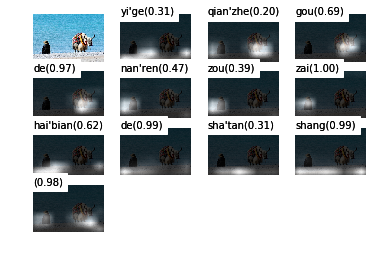

beam search using time(ms): 971.076011658
一个 牵着 狗 的 男人 走 在 海边 的 道路 上 </S> 0.0260329
probs [0.3066738124799828, 0.20407105384537208, 0.6874293955376936, 0.9686666902115766, 0.4738760532220861, 0.3928353169853173, 0.9974710686174045, 0.6199025535075258, 0.9881475651874874, 0.24416497485593944, 0.9994596779996514, 0.972133610364762, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


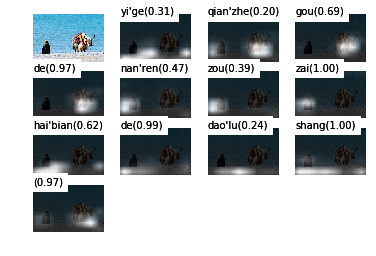

beam search using time(ms): 976.3879776
一个 戴着 帽子 的 男人 牵着 一只 狗 走 在 海边 的 道路 上 </S> 0.0225102
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.3275327634995122, 0.8039417526677662, 0.4461939079169528, 0.8793475458319264, 0.7606599489379914, 0.9986243125466348, 0.5275328245270804, 0.8017834514430722, 0.36418069012969273, 0.999669780133819, 0.9983607029394141, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


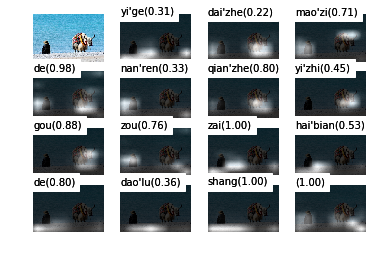

beam search using time(ms): 1183.91990662
一个 牵着 狗 的 女人 走 在 海边 的 沙滩 上 </S> 0.0216545
probs [0.3066738124799828, 0.20407105384537208, 0.6874293955376936, 0.9686666902115766, 0.2332351686565487, 0.35732451356618233, 0.9979168746565341, 0.6267835606751092, 0.9882408100143097, 0.3869591803934907, 0.9888193008101586, 0.9716966937334207, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


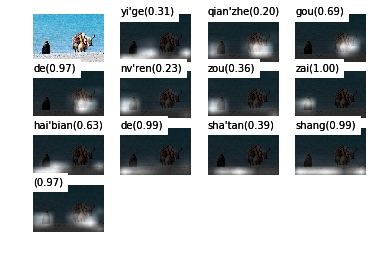

beam search using time(ms): 1204.3941021
一个 戴着 帽子 的 男人 牵着 一只 狗 走 在 道路 上 </S> 0.0183645
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.3275327634995122, 0.8039417526677662, 0.4461939079169528, 0.8793475458319264, 0.7606599489379914, 0.9986243125466348, 0.14155439612475973, 0.9992249063940263, 0.9600030030555281, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


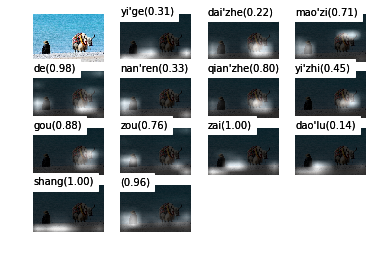

beam search using time(ms): 1213.88697624
一个 戴着 帽子 的 女人 牵着 一只 狗 走 在 海边 的 道路 上 </S> 0.0177977
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.24313766605969206, 0.7660747276806396, 0.41878347311648334, 0.876259370834068, 0.8046970657877225, 0.998704920741125, 0.5029425731940651, 0.8101893395359376, 0.34015329728210525, 0.9996862204234057, 0.9983873190493714, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


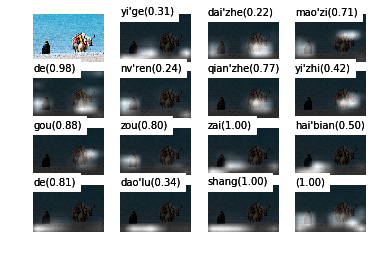

beam search using time(ms): 1324.16605949
一个 戴着 帽子 的 男人 牵着 一条 狗 走 在 海边 的 道路 上 </S> 0.0176607
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.3275327634995122, 0.8039417526677662, 0.26108248872611994, 0.9458452634243479, 0.7833907833338895, 0.9986322776851673, 0.49839311226086813, 0.8030442223719105, 0.36833008225256986, 0.9996788341505486, 0.9983470389854068, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


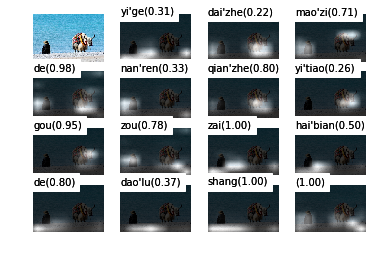

beam search using time(ms): 1597.07379341
一个 戴着 帽子 的 人 牵 着 一只 狗 走 在 海边 的 道路 上 </S> 0.0153702
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.36689206557536375, 0.4277938655419246, 0.9992313337830061, 0.40135121431075027, 0.890249752847228, 0.5651361826139626, 0.998463135203166, 0.42192521410570777, 0.8398015511020148, 0.4452924967284411, 0.9997370934485875, 0.9988076615715541, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


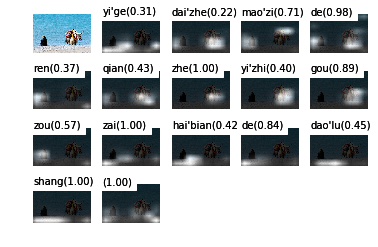

beam search using time(ms): 1323.6451149
一个 戴着 帽子 的 男人 牵着 一只 狗 走 在 海边 的 沙滩 上 </S> 0.0148216
probs [0.3066738124799828, 0.2217780870714804, 0.7142638904549476, 0.9761632357498767, 0.3275327634995122, 0.8039417526677662, 0.4461939079169528, 0.8793475458319264, 0.7606599489379914, 0.9986243125466348, 0.5275328245270804, 0.8017834514430722, 0.1612768791728157, 0.9916759869841819, 0.9985304049890887, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


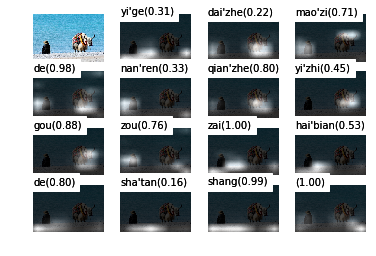

beam search using time(ms): 1309.1340065
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 627e210252a8317d9e7097112bb7ceafd7a3795c.jpg


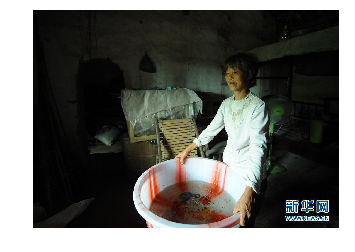

一个 双手 拿 着 盆 的 女人 站 在 房间 里 </S> 0.0534247
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.19814686961899997, 0.9949610324211677, 0.7820131419353327, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


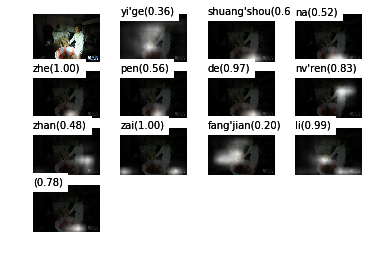

beam search using time(ms): 4544.01183128
一个 双手 拿 着 盆 的 女人 站 在 屋子里 </S> 0.0464869
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.19189582884241532, 0.7012565823228009, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


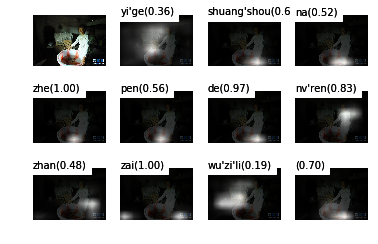

beam search using time(ms): 1579.49304581
一个 双手 端 着 盆 的 女人 站 在 房间 里 </S> 0.0388139
probs [0.3633293018742064, 0.6759151148186152, 0.21781943057057962, 0.9974426036068341, 0.6996007212750854, 0.9517191804649909, 0.7883904081292827, 0.5106398919636707, 0.9990497329675299, 0.20384270096578927, 0.9956082708197966, 0.8155423218582216, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


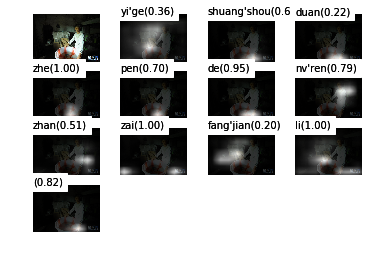

beam search using time(ms): 1698.95601273
一个 双手 端 着 盆 的 女人 站 在 屋子里 </S> 0.034525
probs [0.3633293018742064, 0.6759151148186152, 0.21781943057057962, 0.9974426036068341, 0.6996007212750854, 0.9517191804649909, 0.7883904081292827, 0.5106398919636707, 0.9990497329675299, 0.2067197105666825, 0.7367950867213973, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


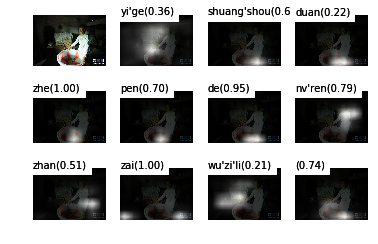

beam search using time(ms): 1592.68403053
一个 双手 拿 着 盆 的 女人 站 在 简陋 的 屋子里 </S> 0.0337788
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.14144559679450142, 0.9891088007666509, 0.41814676693959746, 0.9883985870782744, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


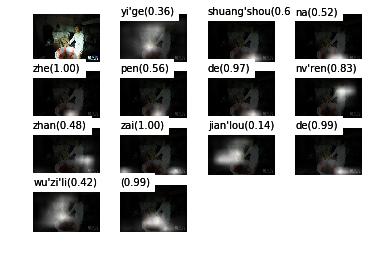

beam search using time(ms): 1837.8238678
一个 双手 拿 着 盆 的 女人 站 在 简陋 的 房间 里 </S> 0.0300665
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.14144559679450142, 0.9891088007666509, 0.2986141092385795, 0.994989592020806, 0.9846523681862493, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


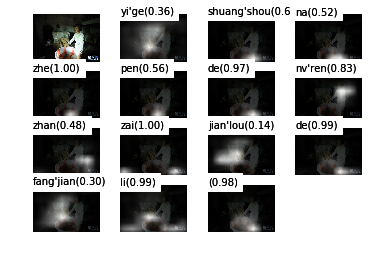

beam search using time(ms): 1970.11899948
一个 双手 拿 着 盆 的 女人 站 在 昏暗 的 屋子里 </S> 0.025643
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.08604132374987461, 0.9992521637698447, 0.4024927847743308, 0.9901689071127342, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


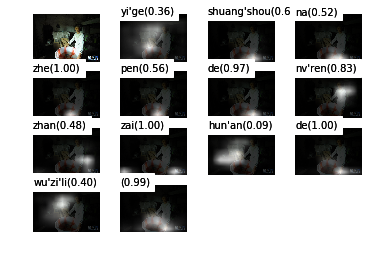

beam search using time(ms): 1725.21209717
房间 里 有 一个 穿着 白色 上衣 的 女人 在 干活 </S> 0.0233117
probs [0.09047371664755505, 0.994763049430394, 0.6807063684858471, 0.9803358053886813, 0.43304065720175183, 0.5591215019674831, 0.6272158997527957, 0.9801062671418874, 0.8996045283566104, 0.7008817322448387, 0.1625290014321772, 0.9995048115406716, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


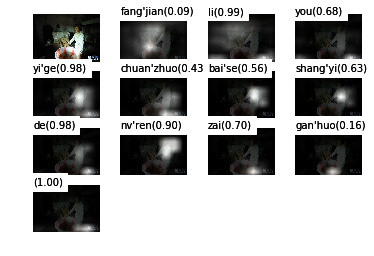

beam search using time(ms): 1649.70397949
一个 双手 拿 着 盆 的 女人 站 在 昏暗 的 房间 里 </S> 0.0225736
probs [0.3633293018742064, 0.6759151148186152, 0.5207402264244523, 0.9989344518331585, 0.5571905889619932, 0.9728486120728649, 0.834836134698866, 0.4815347087945107, 0.9986774554779626, 0.08604132374987461, 0.9992521637698447, 0.27728323188097537, 0.9960623478111302, 0.9900651309937001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


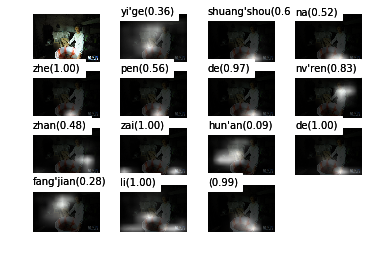

beam search using time(ms): 1990.27204514
房间 里 有 一个 双手 拿 着 盆 的 女人 坐在 凳子 上 </S> 0.0209791
probs [0.09047371664755505, 0.994763049430394, 0.6807063684858471, 0.9803358053886813, 0.2419037879501305, 0.5368359722909066, 0.9971026924236557, 0.612090650006636, 0.9807296158878128, 0.9054419255939931, 0.3071297780431343, 0.4524153805324778, 0.9820730804944388, 0.9834291068093994, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


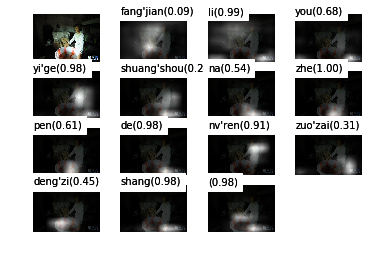

beam search using time(ms): 2634.36293602


In [ ]:
while True:
  image_name = raw_input('image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: ')
  image_name = image_name.strip().replace('file://', '')
  if image_name == 'q':
    break
  if not image_name.endswith('.jpg'):
    image_name += '.jpg'

  image_path = os.path.join(image_dir, image_name)

  if not os.path.exists(image_path):
    print('path not exists:%s'%image_path)
    image_path = image_name
    if not os.path.exists(image_path):
        continue
  plt.subplot(1, 1, 1)
  image_show(image_path)
  predict(image_path, predictor)
  #predict(image_path, predictor2, gen_feature=False)

In [ ]:
import glob 
for img in glob.glob('/home/gezi/new2/data/ai_challenger/image_caption/test_pic/*.jpg'):
    image_show(img)
    predict(img, predictor)